**Data Set Information:**

The dataset contains 9358 instances of hourly averaged responses from an array of 5 metal oxide chemical sensors embedded in an Air Quality Chemical Multisensor Device. The device was located on the field in a significantly polluted area, at road level,within an Italian city. Data were recorded from March 2004 to February 2005 (one year)representing the longest freely available recordings of on field deployed air quality chemical sensor devices responses. Ground Truth hourly averaged concentrations for CO, Non Metanic Hydrocarbons, Benzene, Total Nitrogen Oxides (NOx) and Nitrogen Dioxide (NO2) and were provided by a co-located reference certified analyzer. Evidences of cross-sensitivities as well as both concept and sensor drifts are present as described in De Vito et al., Sens. And Act. B, Vol. 129,2,2008 (citation required) eventually affecting sensors concentration estimation capabilities. Missing values are tagged with -200 value.

**Attribute Information**:

0. Date (DD/MM/YYYY)
1. Time (HH.MM.SS)
2. True hourly averaged concentration CO in mg/m^3 (reference analyzer)
3. PT08.S1 (tin oxide) hourly averaged sensor response (nominally CO targeted)
4. True hourly averaged overall Non Metanic HydroCarbons concentration in microg/m^3 (reference analyzer)
5. True hourly averaged Benzene concentration in microg/m^3 (reference analyzer)
6. PT08.S2 (titania) hourly averaged sensor response (nominally NMHC targeted)
7. True hourly averaged NOx concentration in ppb (reference analyzer)
8. PT08.S3 (tungsten oxide) hourly averaged sensor response (nominally NOx targeted)
9. True hourly averaged NO2 concentration in microg/m^3 (reference analyzer)
10. PT08.S4 (tungsten oxide) hourly averaged sensor response (nominally NO2 targeted)
11. PT08.S5 (indium oxide) hourly averaged sensor response (nominally O3 targeted)
12. Temperature in Â°C
13. Relative Humidity (%)
14. AH Absolute Humidity

**Target - C6H6(GT)**

*-200 indicates missing values*

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
import seaborn as sns
import missingno as msno
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
import scipy.stats as stats
from sklearn.metrics import mean_absolute_error as mae
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import r2_score as r2
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge, Lasso, ElasticNet
from sklearn.linear_model import RidgeCV, LassoCV, ElasticNetCV
from sklearn.preprocessing import PolynomialFeatures
import warnings

In [2]:
warnings.simplefilter(action="ignore", category=FutureWarning)

In [3]:
df = pd.read_csv("data/AirQualityUCI.csv", sep=";")

---

# EDA and Basic Engineering

## Data Inspection

In [4]:
df

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Unnamed: 15,Unnamed: 16
0,10/03/2004,18.00.00,"2,6",1360.0,150.0,"11,9",1046.0,166.0,1056.0,113.0,1692.0,1268.0,"13,6","48,9","0,7578",NaN,NaN
1,10/03/2004,19.00.00,2,1292.0,112.0,"9,4",955.0,103.0,1174.0,92.0,1559.0,972.0,"13,3","47,7","0,7255",NaN,NaN
2,10/03/2004,20.00.00,"2,2",1402.0,88.0,"9,0",939.0,131.0,1140.0,114.0,1555.0,1074.0,"11,9","54,0","0,7502",NaN,NaN
3,10/03/2004,21.00.00,"2,2",1376.0,80.0,"9,2",948.0,172.0,1092.0,122.0,1584.0,1203.0,"11,0","60,0","0,7867",NaN,NaN
4,10/03/2004,22.00.00,"1,6",1272.0,51.0,"6,5",836.0,131.0,1205.0,116.0,1490.0,1110.0,"11,2","59,6","0,7888",NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9466,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9467,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9468,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9469,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


- helper function for deleting features

In [5]:
def drop_features(features):
    df.drop(columns=features, inplace=True)  

In [6]:
drop_features(["Unnamed: 15", "Unnamed: 16"])
df.head(10).T

,0,1,2,3,4,5,6,7,8,9
Date,10/03/2004,10/03/2004,10/03/2004,10/03/2004,10/03/2004,10/03/2004,11/03/2004,11/03/2004,11/03/2004,11/03/2004
Time,18.00.00,19.00.00,20.00.00,21.00.00,22.00.00,23.00.00,00.00.00,01.00.00,02.00.00,03.00.00
CO(GT),"2,6",2,"2,2","2,2","1,6","1,2","1,2",1,"0,9","0,6"
PT08.S1(CO),1360.0,1292.0,1402.0,1376.0,1272.0,1197.0,1185.0,1136.0,1094.0,1010.0
NMHC(GT),150.0,112.0,88.0,80.0,51.0,38.0,31.0,31.0,24.0,19.0
C6H6(GT),"11,9","9,4","9,0","9,2","6,5","4,7","3,6","3,3","2,3","1,7"
PT08.S2(NMHC),1046.0,955.0,939.0,948.0,836.0,750.0,690.0,672.0,609.0,561.0
NOx(GT),166.0,103.0,131.0,172.0,131.0,89.0,62.0,62.0,45.0,-200.0
PT08.S3(NOx),1056.0,1174.0,1140.0,1092.0,1205.0,1337.0,1462.0,1453.0,1579.0,1705.0
NO2(GT),113.0,92.0,114.0,122.0,116.0,96.0,77.0,76.0,60.0,-200.0


Let's check data types of our features and potential missing values

In [7]:
df.dtypes

Date              object
Time              object
CO(GT)            object
PT08.S1(CO)      float64
NMHC(GT)         float64
C6H6(GT)          object
PT08.S2(NMHC)    float64
NOx(GT)          float64
PT08.S3(NOx)     float64
NO2(GT)          float64
PT08.S4(NO2)     float64
PT08.S5(O3)      float64
T                 object
RH                object
AH                object
dtype: object

We should keep in mind that C6H6(GT) is the target feature in this analysis.

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9471 entries, 0 to 9470
Data columns (total 15 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           9357 non-null   object 
 1   Time           9357 non-null   object 
 2   CO(GT)         9357 non-null   object 
 3   PT08.S1(CO)    9357 non-null   float64
 4   NMHC(GT)       9357 non-null   float64
 5   C6H6(GT)       9357 non-null   object 
 6   PT08.S2(NMHC)  9357 non-null   float64
 7   NOx(GT)        9357 non-null   float64
 8   PT08.S3(NOx)   9357 non-null   float64
 9   NO2(GT)        9357 non-null   float64
 10  PT08.S4(NO2)   9357 non-null   float64
 11  PT08.S5(O3)    9357 non-null   float64
 12  T              9357 non-null   object 
 13  RH             9357 non-null   object 
 14  AH             9357 non-null   object 
dtypes: float64(8), object(7)
memory usage: 1.1+ MB


### Missing Values and Features Modifications

As per the description, missing values are marked as -200. It's important to note that for object types (strings), they are indicated as "-200.0" and "200.0."

In [9]:
df.replace(-200, np.NaN, inplace=True)
df.replace("-200", np.NaN, inplace=True)
df.replace("-200,0", np.NaN, inplace=True)
df.replace("-200.0", np.NaN, inplace=True)

In [10]:
df

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,10/03/2004,18.00.00,"2,6",1360.0,150.0,"11,9",1046.0,166.0,1056.0,113.0,1692.0,1268.0,"13,6","48,9","0,7578"
1,10/03/2004,19.00.00,2,1292.0,112.0,"9,4",955.0,103.0,1174.0,92.0,1559.0,972.0,"13,3","47,7","0,7255"
2,10/03/2004,20.00.00,"2,2",1402.0,88.0,"9,0",939.0,131.0,1140.0,114.0,1555.0,1074.0,"11,9","54,0","0,7502"
3,10/03/2004,21.00.00,"2,2",1376.0,80.0,"9,2",948.0,172.0,1092.0,122.0,1584.0,1203.0,"11,0","60,0","0,7867"
4,10/03/2004,22.00.00,"1,6",1272.0,51.0,"6,5",836.0,131.0,1205.0,116.0,1490.0,1110.0,"11,2","59,6","0,7888"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9466,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9467,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9468,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9469,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Now, we can prepare some string-type features and convert them to float. It's also essential to remember to replace "," with "." before the conversion.

In [11]:
def str_to_float(features):
    for feature in features:
        df[feature] = df[feature].str.replace(",", ".")
        df[feature] = df[feature].astype(np.float64)

In [12]:
str_to_float(["C6H6(GT)", "CO(GT)", "T", "RH", "AH"])

Looking at the previous table output, we can observe rows with all NaN values. Let's identify which indices in the dataframe have only NaN values and remove them.

In [13]:
df[df.isnull().all(axis=1)].index

Index([9357, 9358, 9359, 9360, 9361, 9362, 9363, 9364, 9365, 9366,
       ...
       9461, 9462, 9463, 9464, 9465, 9466, 9467, 9468, 9469, 9470],
      dtype='int64', length=114)

In [14]:
df.dropna(how="all", inplace=True)

Now, our data looks better.

In [15]:
df.dtypes

Date              object
Time              object
CO(GT)           float64
PT08.S1(CO)      float64
NMHC(GT)         float64
C6H6(GT)         float64
PT08.S2(NMHC)    float64
NOx(GT)          float64
PT08.S3(NOx)     float64
NO2(GT)          float64
PT08.S4(NO2)     float64
PT08.S5(O3)      float64
T                float64
RH               float64
AH               float64
dtype: object

In [16]:
df.head(10).T

,0,1,2,3,4,5,6,7,8,9
Date,10/03/2004,10/03/2004,10/03/2004,10/03/2004,10/03/2004,10/03/2004,11/03/2004,11/03/2004,11/03/2004,11/03/2004
Time,18.00.00,19.00.00,20.00.00,21.00.00,22.00.00,23.00.00,00.00.00,01.00.00,02.00.00,03.00.00
CO(GT),2.6,2.0,2.2,2.2,1.6,1.2,1.2,1.0,0.9,0.6
PT08.S1(CO),1360.0,1292.0,1402.0,1376.0,1272.0,1197.0,1185.0,1136.0,1094.0,1010.0
NMHC(GT),150.0,112.0,88.0,80.0,51.0,38.0,31.0,31.0,24.0,19.0
C6H6(GT),11.9,9.4,9.0,9.2,6.5,4.7,3.6,3.3,2.3,1.7
PT08.S2(NMHC),1046.0,955.0,939.0,948.0,836.0,750.0,690.0,672.0,609.0,561.0
NOx(GT),166.0,103.0,131.0,172.0,131.0,89.0,62.0,62.0,45.0,NaN
PT08.S3(NOx),1056.0,1174.0,1140.0,1092.0,1205.0,1337.0,1462.0,1453.0,1579.0,1705.0
NO2(GT),113.0,92.0,114.0,122.0,116.0,96.0,77.0,76.0,60.0,NaN


Examine the number of missing values for each feature. We can also display the count of non-NaN values for each feature.

In [17]:
df.isna().sum()

Date                0
Time                0
CO(GT)           1683
PT08.S1(CO)       366
NMHC(GT)         8443
C6H6(GT)          366
PT08.S2(NMHC)     366
NOx(GT)          1639
PT08.S3(NOx)      366
NO2(GT)          1642
PT08.S4(NO2)      366
PT08.S5(O3)       366
T                 366
RH                366
AH                366
dtype: int64

<Axes: >

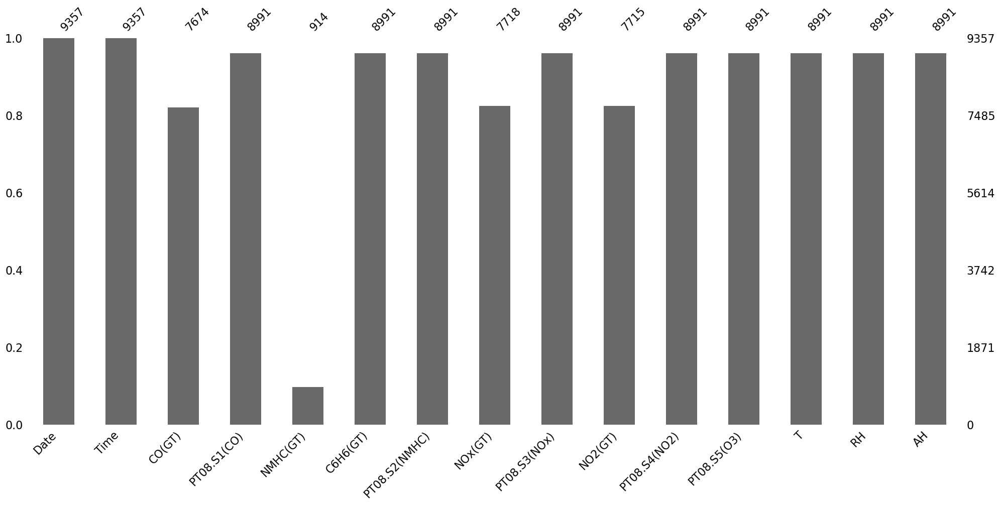

In [18]:
msno.bar(df)

Due to the fact that only slightly less than 10% of the data in the NMHC(GT) feature is non-NaN, we can consider removing it entirely.

In [19]:
drop_features(["NMHC(GT)"])

We can extract two new features, Hour and Month, which will be needed later.

In [20]:
df["Hour"] = df["Time"].apply(lambda x: int(x.split(".")[0]))
drop_features(["Time"])

In [21]:
df["Date"] = pd.to_datetime(df["Date"], format="%d/%m/%Y")
df.set_index("Date", inplace=True)
df["Month"] = df.index.month

Let's remove rows containing missing values in the target feature. We cannot fill values there, as it would lead to data leakage.

In [22]:
df = df[df["C6H6(GT)"].notna()]

We can fill in the remaining features using a method that propagates the last valid observation forward to the next valid one. Therefore, it is essential to ensure that the data is sorted by date before applying this technique. This approach is effective for handling missing values because it avoids referencing overall averages, medians, etc., for the entire period. Instead, it considers each specific short period, typically hour or few hours, assuming that air quality does not change significantly over these periods where data is missing.

In [23]:
df = df.sort_values(by=["Date", "Hour"])

In [24]:
df.fillna(method="ffill", inplace=True)

Let's observe the number of air quality measurements for each day and year.

In [25]:
df.index.day.value_counts()

Date
23    312
12    312
13    312
22    312
18    312
2     309
21    308
1     308
24    307
25    307
14    305
28    302
19    302
17    292
11    290
3     288
15    288
30    288
20    288
27    288
16    288
6     288
7     287
5     287
29    286
26    285
4     279
10    270
8     263
9     237
31    191
Name: count, dtype: int64

In [26]:
df.index.year.value_counts()

Date
2004    6882
2005    2109
Name: count, dtype: int64

Given that the measurement period spans from March 2004 to March 2005 inclusive, we can safely remove the 'Date' column since we have already extracted 'Hour' and 'Month' earlier. It is reasonable to assume that the year and day-of-month will no longer be needed. From personal observations, I can confirm that air quality changes concerning specific weekdays are not significantly different for most of the cities. Hence, we will not make a distinction between Monday, Tuesday, etc.

Due to the removal of the year, some days in March will be duplicated, but this won't impact regression models significantly.

In [27]:
df.reset_index(inplace=True)
drop_features(["Date"])
df.T

,0,1,2,3,4,5,6,7,8,9,...,8981,8982,8983,8984,8985,8986,8987,8988,8989,8990
CO(GT),2.6000,2.0000,2.2000,2.2000,1.6000,1.2000,1.2000,1.0000,0.9000,0.6000,...,0.500,1.1000,4.0000,5.0000,3.9000,3.1000,2.4000,2.4000,2.1000,2.2000
PT08.S1(CO),1360.0000,1292.0000,1402.0000,1376.0000,1272.0000,1197.0000,1185.0000,1136.0000,1094.0000,1010.0000,...,888.000,1031.0000,1384.0000,1446.0000,1297.0000,1314.0000,1163.0000,1142.0000,1003.0000,1071.0000
C6H6(GT),11.9000,9.4000,9.0000,9.2000,6.5000,4.7000,3.6000,3.3000,2.3000,1.7000,...,1.300,4.4000,17.4000,22.4000,13.6000,13.5000,11.4000,12.4000,9.5000,11.9000
PT08.S2(NMHC),1046.0000,955.0000,939.0000,948.0000,836.0000,750.0000,690.0000,672.0000,609.0000,561.0000,...,528.000,730.0000,1221.0000,1362.0000,1102.0000,1101.0000,1027.0000,1063.0000,961.0000,1047.0000
NOx(GT),166.0000,103.0000,131.0000,172.0000,131.0000,89.0000,62.0000,62.0000,45.0000,45.0000,...,77.000,182.0000,594.0000,586.0000,523.0000,472.0000,353.0000,293.0000,235.0000,265.0000
PT08.S3(NOx),1056.0000,1174.0000,1140.0000,1092.0000,1205.0000,1337.0000,1462.0000,1453.0000,1579.0000,1705.0000,...,1077.000,760.0000,470.0000,415.0000,507.0000,539.0000,604.0000,603.0000,702.0000,654.0000
NO2(GT),113.0000,92.0000,114.0000,122.0000,116.0000,96.0000,77.0000,76.0000,60.0000,60.0000,...,53.000,93.0000,155.0000,174.0000,187.0000,190.0000,179.0000,175.0000,156.0000,168.0000
PT08.S4(NO2),1692.0000,1559.0000,1555.0000,1584.0000,1490.0000,1393.0000,1333.0000,1333.0000,1276.0000,1235.0000,...,987.000,1129.0000,1600.0000,1777.0000,1375.0000,1374.0000,1264.0000,1241.0000,1041.0000,1129.0000
PT08.S5(O3),1268.0000,972.0000,1074.0000,1203.0000,1110.0000,949.0000,733.0000,730.0000,620.0000,501.0000,...,578.000,905.0000,1457.0000,1705.0000,1583.0000,1729.0000,1269.0000,1092.0000,770.0000,816.0000
T,13.6000,13.3000,11.9000,11.0000,11.2000,11.2000,11.3000,10.7000,10.7000,10.3000,...,10.400,9.5000,9.7000,13.5000,18.2000,21.9000,24.3000,26.9000,28.3000,28.5000


In [28]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8991 entries, 0 to 8990
Data columns (total 14 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   CO(GT)         8991 non-null   float64
 1   PT08.S1(CO)    8991 non-null   float64
 2   C6H6(GT)       8991 non-null   float64
 3   PT08.S2(NMHC)  8991 non-null   float64
 4   NOx(GT)        8991 non-null   float64
 5   PT08.S3(NOx)   8991 non-null   float64
 6   NO2(GT)        8991 non-null   float64
 7   PT08.S4(NO2)   8991 non-null   float64
 8   PT08.S5(O3)    8991 non-null   float64
 9   T              8991 non-null   float64
 10  RH             8991 non-null   float64
 11  AH             8991 non-null   float64
 12  Hour           8991 non-null   int64  
 13  Month          8991 non-null   int32  
dtypes: float64(12), int32(1), int64(1)
memory usage: 948.4 KB


### Duplicates

Let's check for duplicates in our dataset:

In [29]:
df.duplicated().sum()

0

### Feature Division

In [30]:
target = "C6H6(GT)"
target_feature = [target]
categorical_features = ["Month", "Hour"]
numerical_features = [col for col in df.columns if col not in (categorical_features + target_feature)]

In [31]:
df[target_feature]

,C6H6(GT)
0,11.9
1,9.4
2,9.0
3,9.2
4,6.5
...,...
8986,13.5
8987,11.4
8988,12.4
8989,9.5


In [32]:
df[categorical_features]

,Month,Hour
0,3,18
1,3,19
2,3,20
3,3,21
4,3,22
...,...,...
8986,4,10
8987,4,11
8988,4,12
8989,4,13


In [33]:
df[numerical_features]

,CO(GT),PT08.S1(CO),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,2.6,1360.0,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578
1,2.0,1292.0,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255
2,2.2,1402.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502
3,2.2,1376.0,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867
4,1.6,1272.0,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888
...,...,...,...,...,...,...,...,...,...,...,...
8986,3.1,1314.0,1101.0,472.0,539.0,190.0,1374.0,1729.0,21.9,29.3,0.7568
8987,2.4,1163.0,1027.0,353.0,604.0,179.0,1264.0,1269.0,24.3,23.7,0.7119
8988,2.4,1142.0,1063.0,293.0,603.0,175.0,1241.0,1092.0,26.9,18.3,0.6406
8989,2.1,1003.0,961.0,235.0,702.0,156.0,1041.0,770.0,28.3,13.5,0.5139


---

## Descriptive Statistics

- helper function

Now we can create a helper function for basic statistics for numerical features.

In [34]:
def get_extended_description(df):
    extended_describe = df.describe().T
    extended_describe["IQR"] = extended_describe["75%"] - extended_describe["25%"]
    extended_describe["lower_limit"] = extended_describe["25%"] - 1.5*extended_describe["IQR"]
    extended_describe["upper_limit"] = extended_describe["75%"] + 1.5*extended_describe["IQR"]
    return extended_describe

In [35]:
extended_describe = get_extended_description(df)
extended_describe

,count,mean,std,min,25%,50%,75%,max,IQR,lower_limit,upper_limit
CO(GT),8991.0,2.060405,1.458628,0.1000,1.0000,1.7000,2.7000,11.900,1.7000,-1.55000,5.25000
PT08.S1(CO),8991.0,1099.833166,217.080037,647.0000,937.0000,1063.0000,1231.0000,2040.000,294.0000,496.00000,1672.00000
C6H6(GT),8991.0,10.083105,7.449820,0.1000,4.4000,8.2000,14.0000,63.700,9.6000,-10.00000,28.40000
PT08.S2(NMHC),8991.0,939.153376,266.831429,383.0000,734.5000,909.0000,1116.0000,2214.000,381.5000,162.25000,1688.25000
NOx(GT),8991.0,236.863864,201.004000,2.0000,96.0000,172.0000,314.0000,1479.000,218.0000,-231.00000,641.00000
PT08.S3(NOx),8991.0,835.493605,256.817320,322.0000,658.0000,806.0000,969.5000,2683.000,311.5000,190.75000,1436.75000
NO2(GT),8991.0,108.525637,46.565848,2.0000,73.0000,102.0000,136.0000,333.000,63.0000,-21.50000,230.50000
PT08.S4(NO2),8991.0,1456.264598,346.206794,551.0000,1227.0000,1463.0000,1674.0000,2775.000,447.0000,556.50000,2344.50000
PT08.S5(O3),8991.0,1022.906128,398.484288,221.0000,731.5000,963.0000,1273.5000,2523.000,542.0000,-81.50000,2086.50000
T,8991.0,18.317829,8.832116,-1.9000,11.8000,17.8000,24.4000,44.600,12.6000,-7.10000,43.30000


Let's also examine the number of unique values for a particular feature:

In [36]:
df.nunique()

CO(GT)             94
PT08.S1(CO)      1041
C6H6(GT)          407
PT08.S2(NMHC)    1245
NOx(GT)           898
PT08.S3(NOx)     1221
NO2(GT)           274
PT08.S4(NO2)     1603
PT08.S5(O3)      1743
T                 436
RH                753
AH               6683
Hour               24
Month              12
dtype: int64

---

## Data Visualization

For visualization purposes, we can categorize hours into different parts of the day:

In [37]:
df["HourRange"] = pd.cut(df["Hour"], bins=[-1, 5, 11, 17, 23], labels=["0-5", "6-11", "12-17", "18-23"])

- Helper functions for visualization

In [38]:
def cat_countplot(feature, hue=None):
    sns.countplot(data=df, x=feature, hue=hue)
    plt.xticks(rotation=90)
    plt.title(f"Count of '{feature}' Feature Values")
    plt.show()

In [39]:
def dist_kde_plot(feature, hue=None, kind="hist"):
    sns.displot(data=df, x=feature, hue=hue, kind=kind)
    plt.title(f"Distribution of '{feature}' Feature Values")
    plt.show()

In [40]:
def descriptive_plots(df, include_target=True, n_rows=4, n_cols=3):
    fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(15, 12))
    axes = axes.flatten()
    numerical = numerical_features + target_feature if include_target else numerical_features
    extended_describe = get_extended_description(df[numerical])
    
    for i, feature in enumerate(numerical):
        g = sns.histplot(data=df, x=feature, ax=axes[i], kde=True)

        axes[i].axvline(extended_describe.loc[feature, "upper_limit"], linewidth=2 , color="red")
        axes[i].axvline(extended_describe.loc[feature, "lower_limit"], linewidth=2 , color="red")
        axes[i].axvline(extended_describe.loc[feature, "mean"], linewidth=3 , color="yellow")
        axes[i].axvline(extended_describe.loc[feature, "50%"], linewidth=3 , color="magenta")
        g.set(ylabel=None)

    limits = mlines.Line2D([], [], color="red", linewidth=1, label="upper limit / lower limit")
    mean = mlines.Line2D([], [], color="yellow", linewidth=1, label="mean")
    median = mlines.Line2D([], [], color="magenta", linewidth=1, label="median")

    plt.legend(handles=[limits, mean, median], loc="center left", bbox_to_anchor=(1, 0.5))
    plt.suptitle("Numerical Features Histograms", fontsize=16)
    fig.text(0, 0.5, "Count", va="center", rotation="vertical", fontsize=16)

    plt.tight_layout()
    plt.show()

In [41]:
def violin_plots(df, x=None, hue=None):
    fig, axes = plt.subplots(nrows=6, ncols=2, figsize=(12, 20))
    axes = axes.flatten()
    numerical = numerical_features + target_feature
    x = "HourRange" if x == "Hour" else x
    
    for i, feature in enumerate(numerical):
        sns.violinplot(data=df, x=x, y=feature, hue=hue, ax=axes[i], split=True, inner="quart")
        axes[i].tick_params(axis="x", rotation=90)
        axes[i].grid(axis="y")
        
    plt.suptitle("Numerical features violinplots")
    plt.tight_layout()
    plt.show()

In [42]:
def box_plots(df, x=None, hue=None):
    fig, axes = plt.subplots(nrows=6, ncols=2, figsize=(12, 20))
    axes = axes.flatten()
    numerical = numerical_features + target_feature
    
    for i, feature in enumerate(numerical):
        sns.boxplot(data=df, x=x, y=feature, hue=hue, ax=axes[i])
        axes[i].tick_params(axis="x", rotation=90)
        axes[i].grid(axis="y")
        
    plt.suptitle("Numerical features boxplots")
    plt.tight_layout()
    plt.show()

In [43]:
def kde_plots(df, hue=None):
    fig, axes = plt.subplots(nrows=12, ncols=1, figsize=(12, 90))
    axes = axes.flatten()
    numerical = numerical_features + target_feature
    hue = "HourRange" if hue == "Hour" else hue
    
    for i, feature in enumerate(numerical):
        sns.kdeplot(data=df, x=feature, hue=hue, ax=axes[i], palette="bright")
        axes[i].grid()

    plt.tight_layout()
    plt.show()

In [44]:
def scatter_plots(df, hue=None):
    fig, axes = plt.subplots(nrows=11, ncols=1, figsize=(12, 90))
    axes = axes.flatten()
    hue = "HourRange" if hue == "Hour" else hue

    for i, feature in enumerate(numerical_features):
        sns.scatterplot(data=df, x=feature, y=target, hue=hue, ax=axes[i], palette="bright")
        axes[i].grid()

    plt.tight_layout()
    plt.show()

### Univariate Analysis

#### Target Feature

/Users/kkozik/Library/anaconda3/envs/psi_env/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


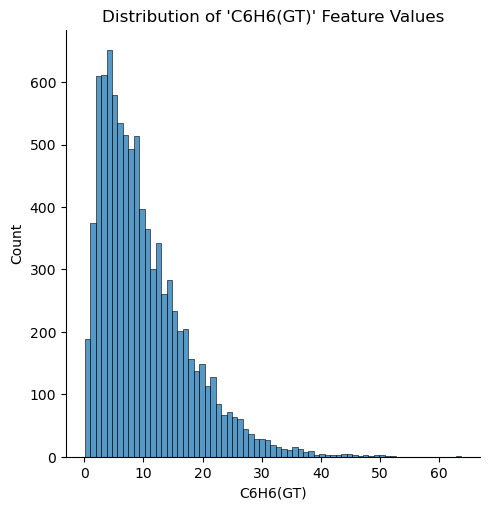

In [45]:
dist_kde_plot(target)

We can observe that the distribution of the target data is slightly positively skewed.

#### Categorical Features

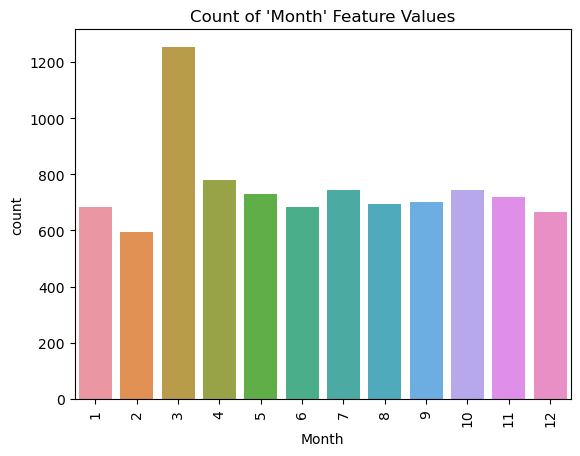

In [46]:
cat_countplot(categorical_features[0])

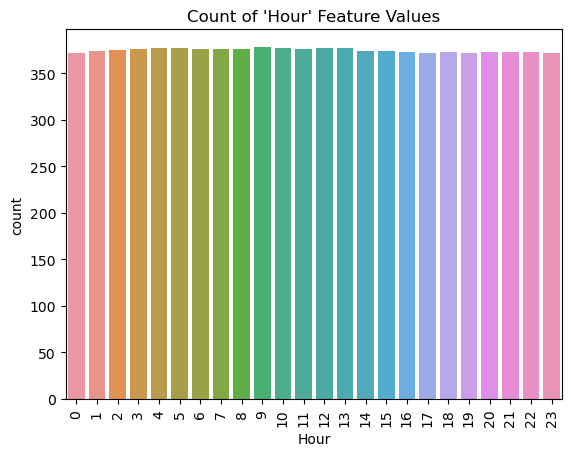

In [47]:
cat_countplot(categorical_features[1])

We can notice that a higher number of measurements were taken in March. This is because it's the only month considered in two different years.

#### Numerical Features

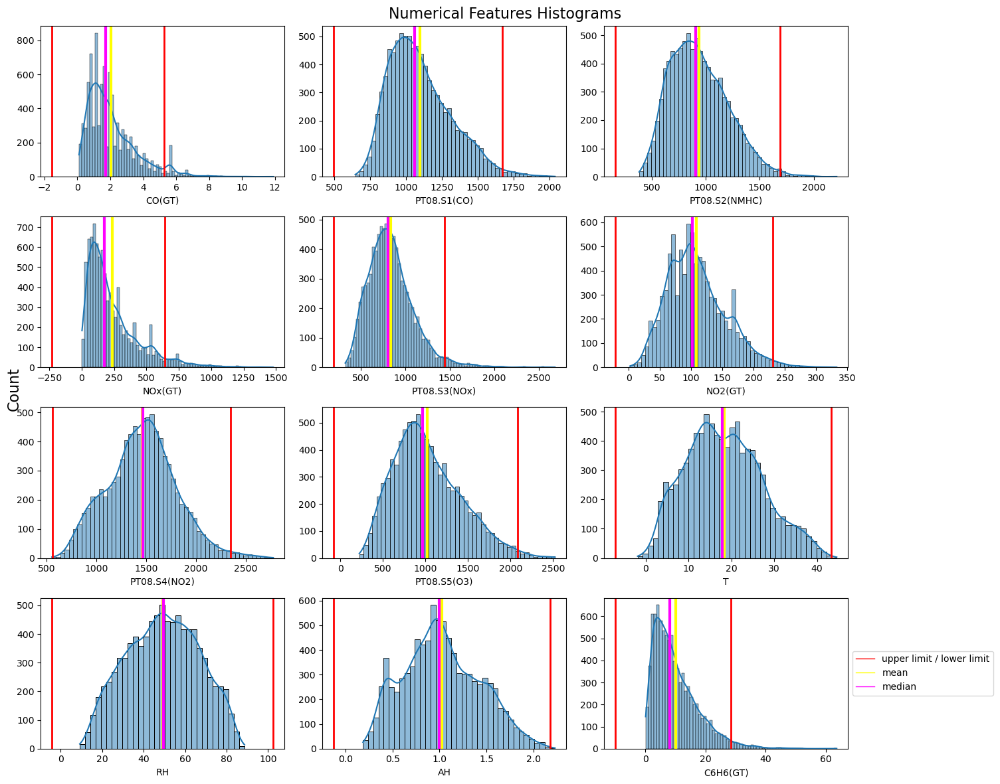

In [48]:
descriptive_plots(df)

All numerical features' distributions are close to Gaussian distributions. Some of them have slight skewness, hence in the further analysis, they will undergo transformations.

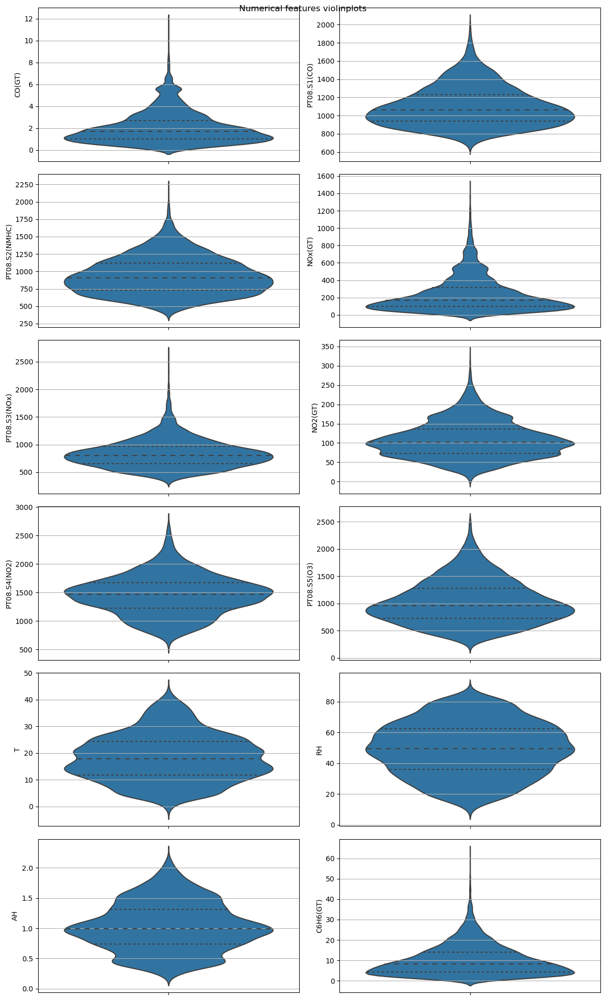

In [49]:
violin_plots(df)

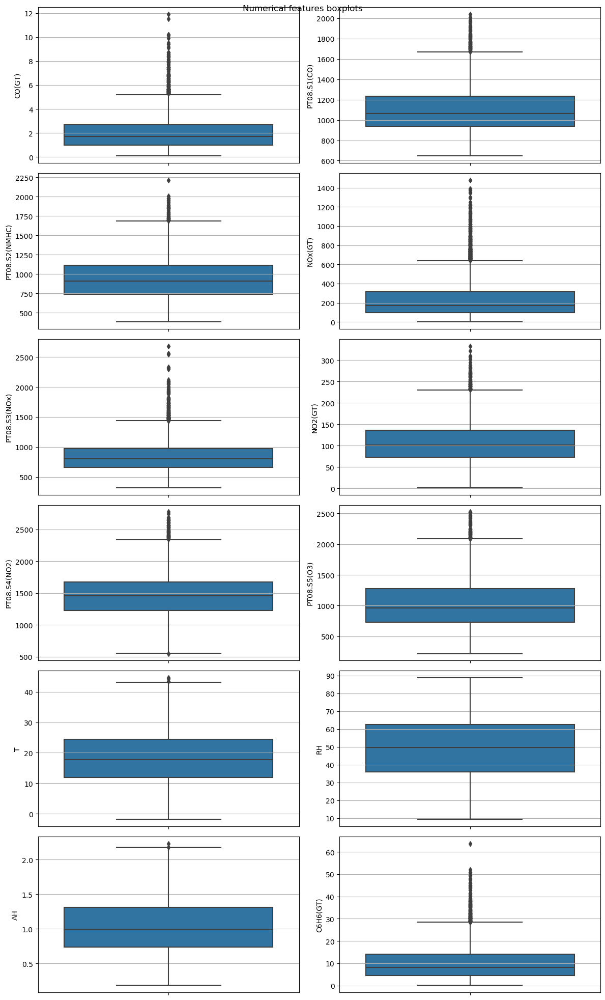

In [50]:
box_plots(df)

Similar conclusions can be drawn based on the above boxplots and violin plots. Some of the data needs to undergo transformation to improve data quality and enable the application of techniques suitable for this model, such as the standard scaler. This scaler should be applied to data with a distribution similar to Gaussian to enhance data quality and facilitate the use of appropriate modeling techniques.

### Multivariate Analysis

- KDE numerical vs categorical

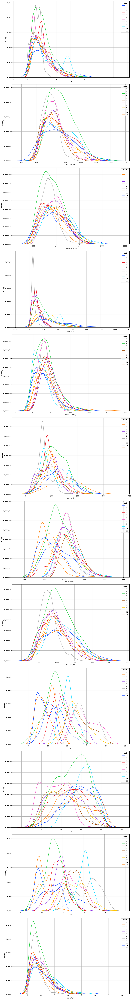

In [51]:
kde_plots(df, hue=categorical_features[0])

In terms of average CO concentration, the most dense distribution is around 2 mg/m^3 for all months. Additionally, a notable peak in density is observed for higher values of CO concentration, specifically around 6 mg/m^3, occurring predominantly in October.

We can observe that the peak density in the hourly averaged sensor responses for CO, NMHC, NOx, and O3 is concentrated around specific values throughout all months. However, the sensor for NO2 exhibits peaks at lower values during the months between November and February. During spring and summer, the hourly averaged sensor responses for NO2 show higher values.

The majority of values for the true hourly averaged NO2 concentration are around 50 (µg/m^3) only in August. The remaining months exhibit a distinctly different density distribution, generally with higher values. It may be caused by seasonal variations influenced by factors such as weather conditions or industrial activities. A potential reason for this phenomenon could be the high temperature and low humidity, as evident in plots featuring temperature (T) and relative humidity (RH) as key features.

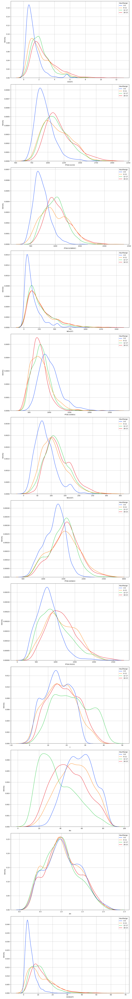

In [52]:
kde_plots(df, hue=categorical_features[1])

For the majority of records, average concentrations of CO, NO2, NOx and C6H6 are lower in the time range between 1 am to 5 am. This could be attributed to reduced human activity during these early morning hours, leading to lower emissions from sources such as vehicle exhaust and industrial facilities.

We can observe a drop in relative humidity values during day (from 12 to 17pm).

- Violin plots numerical vs categorical

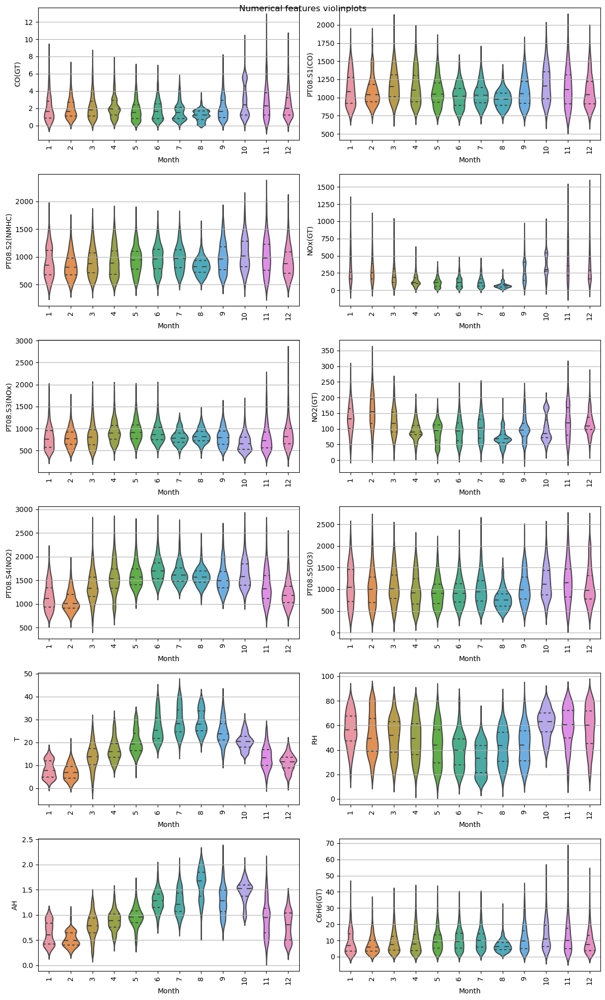

In [53]:
violin_plots(df, x=categorical_features[0])

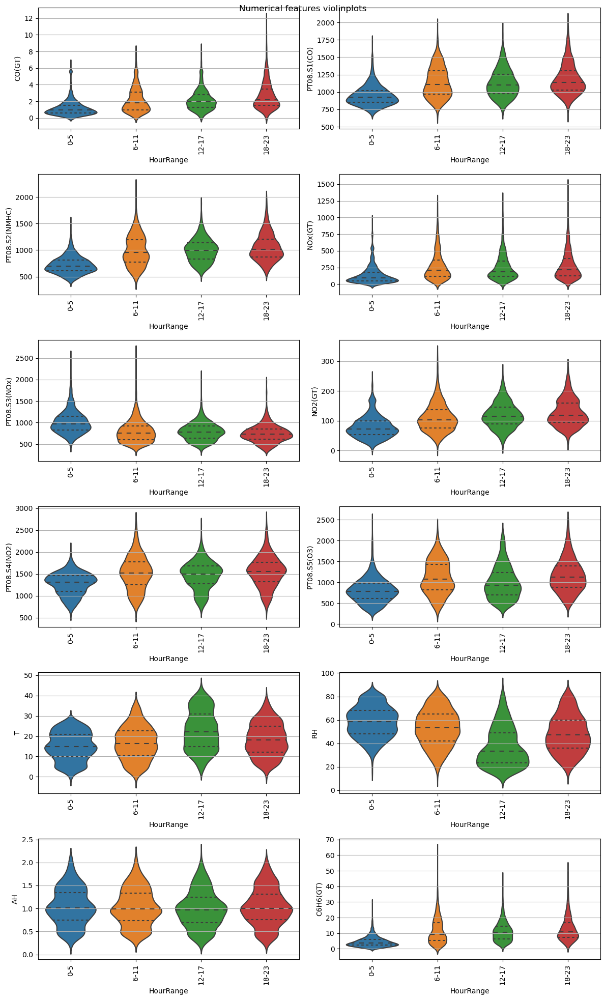

In [54]:
violin_plots(df, x=categorical_features[1])

The same observations can be deduced from violin plots, noting more details such as quartiles, median values, and distributions.

- Box plots numerical vs categorical

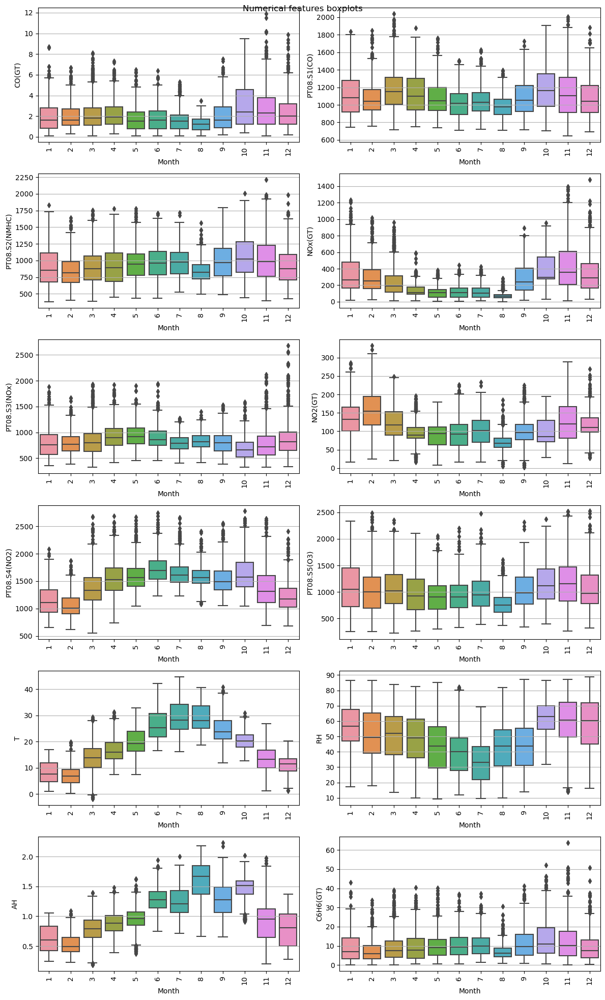

In [55]:
box_plots(df, x=categorical_features[0])

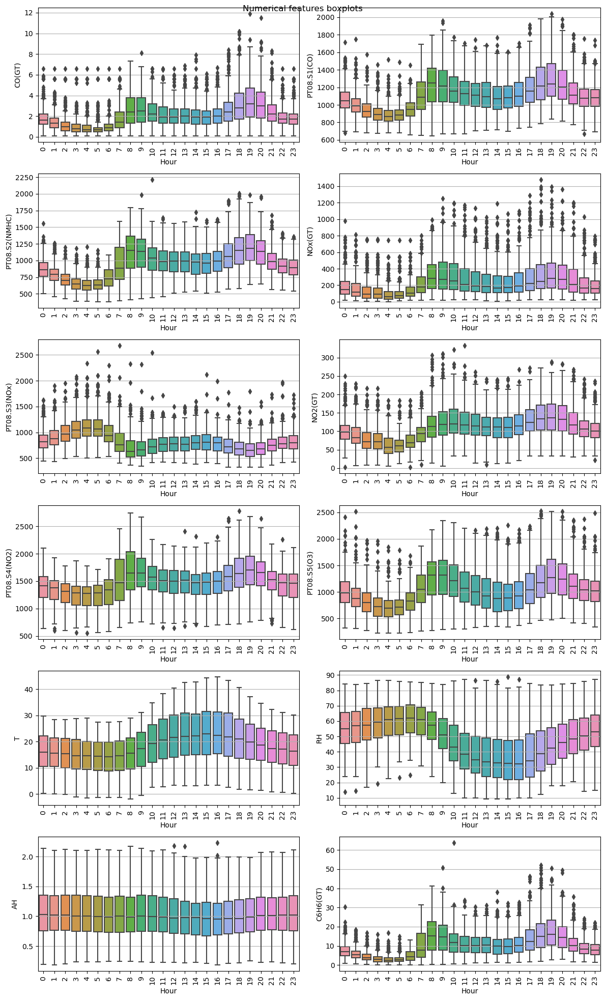

In [56]:
box_plots(df, x=categorical_features[1])

On some of the boxplots, certain outliers are noticeable. It's important to emphasize that these outliers represent a naturally distributed pattern and shouldn't be artificially removed from the model. This approach ensures a more accurate reflection of reality.

- scatter plots

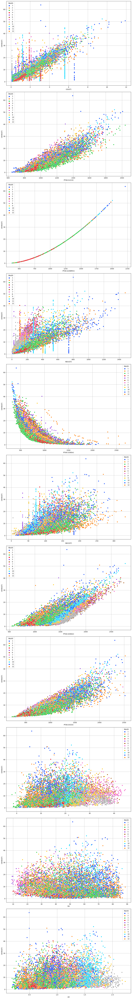

In [57]:
scatter_plots(df, hue=categorical_features[0])

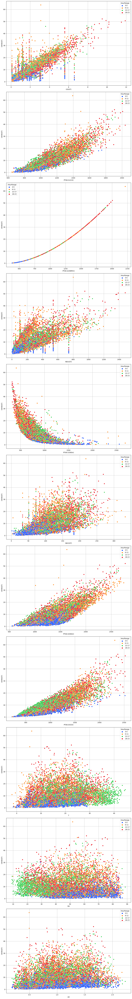

In [58]:
scatter_plots(df, hue=categorical_features[1])

From the scatterplots above, we can see strong correlations between some features and the target variable. Especially notable is the strong positive correlation between the target variable and PT08.S2(NMHC). Also, worth mentioning are the correlations between the target variable and CO(GT), PT08.S1(CO), PT08.S3(NOx), PT08.S5(O3).

These patterns are also clearly evident when analyzing the correlation matrix and pairplot, which will be presented below:

- pairplots

/Users/kkozik/Library/anaconda3/envs/psi_env/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


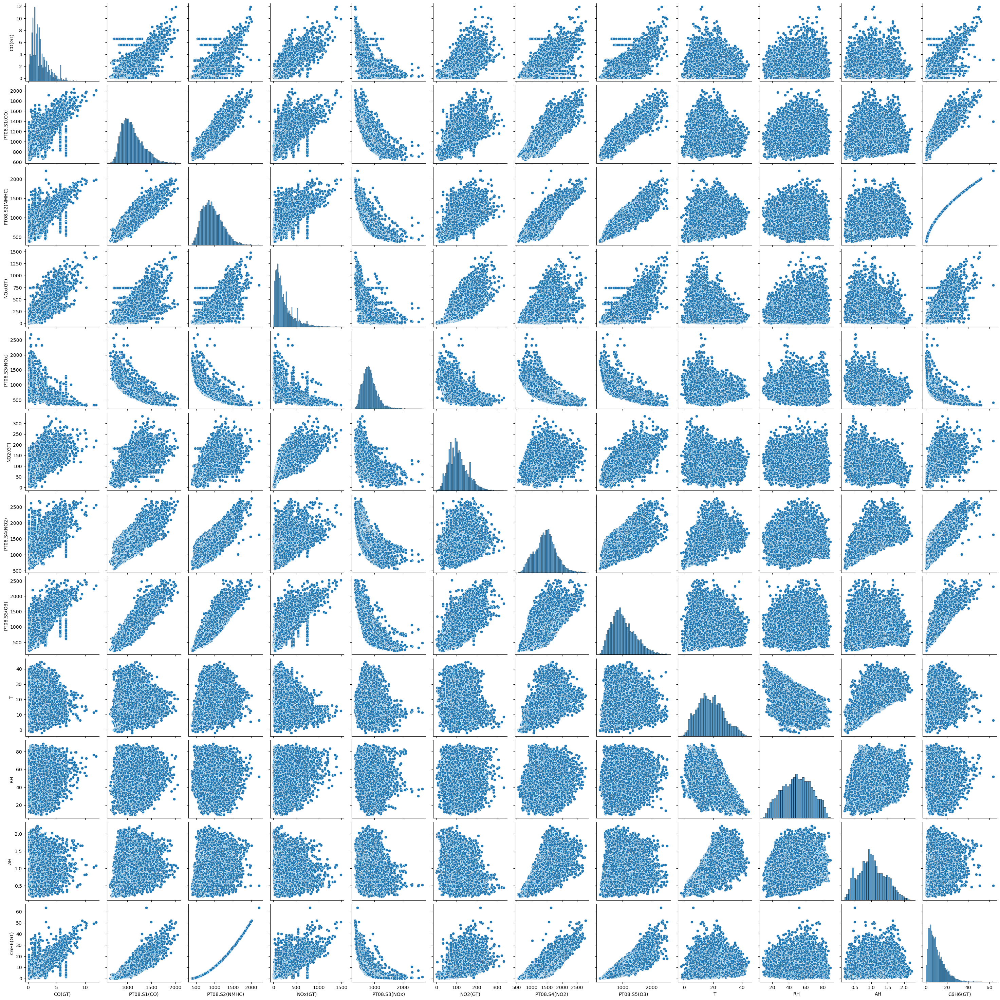

In [59]:
sns.pairplot(df[numerical_features+target_feature])

- Pearson Correlations

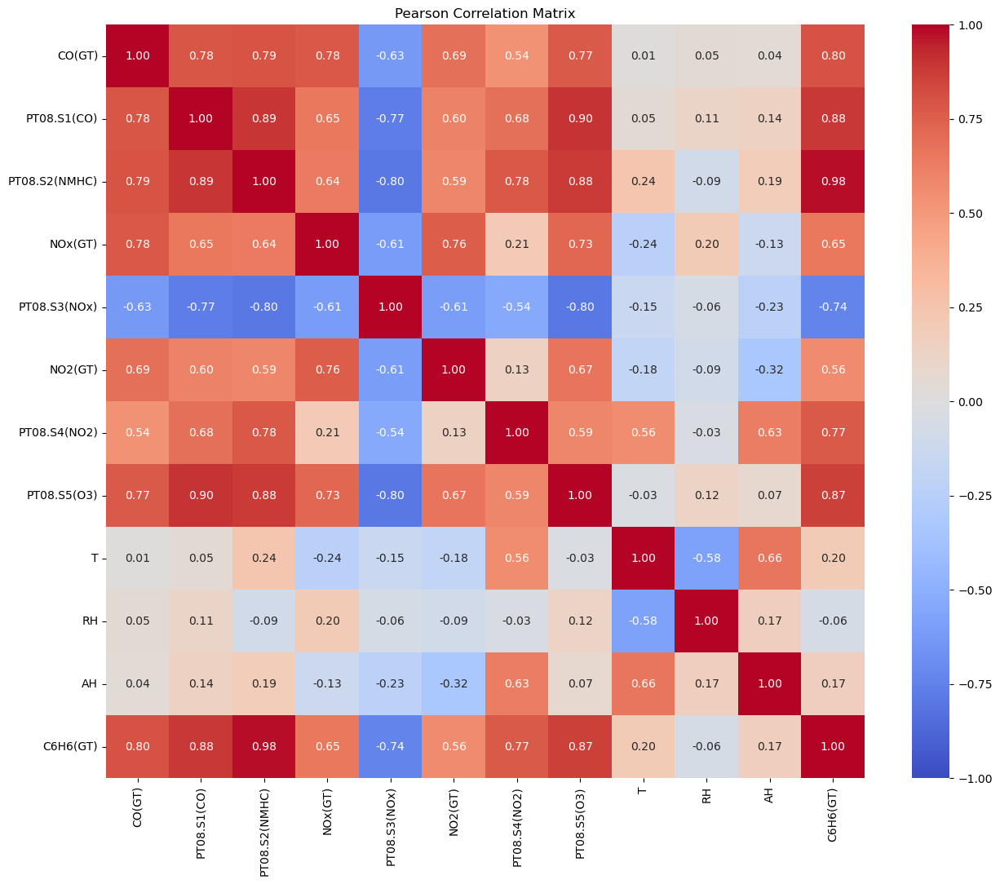

In [60]:
fig, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(df[numerical_features+target_feature].corr(), cmap="coolwarm", annot=True, fmt=".2f", vmin=-1, vmax=1)
plt.title("Pearson Correlation Matrix")
plt.show()

Let's create a function to examine the statistical significance of correlations between pairs of features in a given dataset. If the p-value is greater than 0.05, the function considers the correlation between two features as statistically insignificant. This threshold (0.05) is a common significance level, but it can be adjusted based on the desired level of confidence in hypothesis testing.

In [61]:
def check_correlation_importance(data, corr_type):
    cnt = 0
    feature_names = data.columns.values
    for f1 in feature_names:
        for f2 in feature_names:
            if corr_type == "pearson":
                statistic, pvalue = stats.pearsonr(data[f1], data[f2])
            elif corr_type == "spearman":
                statistic, pvalue = stats.spearmanr(data[f1], data[f2])
            else:
                return

            if statistic < 0.7 and statistic > -0.7:
                continue
            if pvalue > 0.05:
                cnt += 1
                print(f"Statistically insignificant correlation between {f1} and {f2} with correlation coefficient {statistic}", end="\n\n")
    if cnt == 0:
        print("All correlation pairs are statistically significant")

In [62]:
check_correlation_importance(df[numerical_features+target_feature], corr_type="pearson")

All correlation pairs are statistically significant


- Spearman Correlations

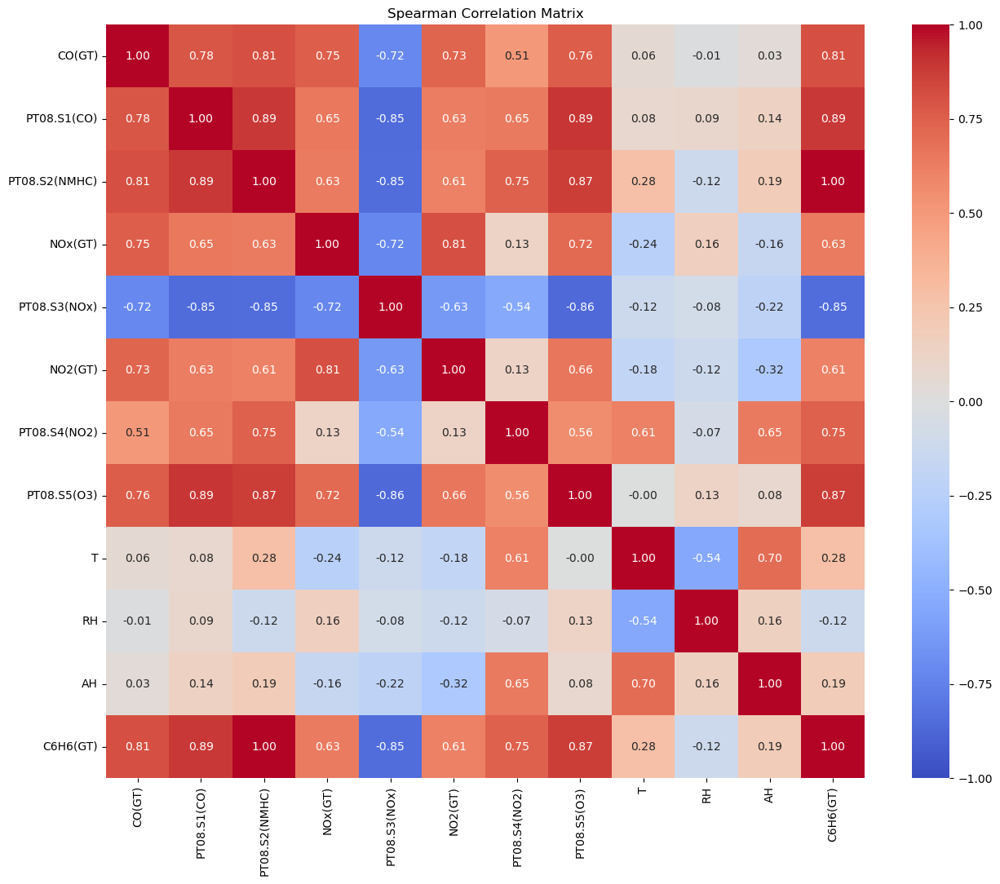

In [63]:
fig, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(df[numerical_features+target_feature].corr(method="spearman"), cmap="coolwarm", annot=True, fmt=".2f", vmin=-1, vmax=1)
plt.title("Spearman Correlation Matrix")
plt.show()

In [64]:
check_correlation_importance(df[numerical_features+target_feature], corr_type="spearman")

All correlation pairs are statistically significant


Due to the fact that each correlation pair with an absolute value of correlation coefficient greater than 0.7 is statistically significant, at this stage of analysis, no features will be removed. We will assess the influence of the highly correlated feature, PT08.S2(NMHC), on the model accuracy later on.

---

# Feature Engineering and Data Preparation

## Nonlinear Transformations

Observing the previous histograms of numerical features, we can reduce skewness by applying a logarithmic transformation. This is a common method used to prepare data for standardization.

It's worth mentioning that transformations can also be applied to the target feature. However, it's important to remember to apply the inverse transformation when evaluating the model results, especially for metrics like R2, MAE, and MSE.

In [65]:
features_with_skewness = ["CO(GT)", "PT08.S1(CO)", "PT08.S2(NMHC)", "NOx(GT)", 
                          "PT08.S3(NOx)", "NO2(GT)", "PT08.S5(O3)", "C6H6(GT)"]
df[features_with_skewness] = df[features_with_skewness].apply(lambda x: np.log(x))

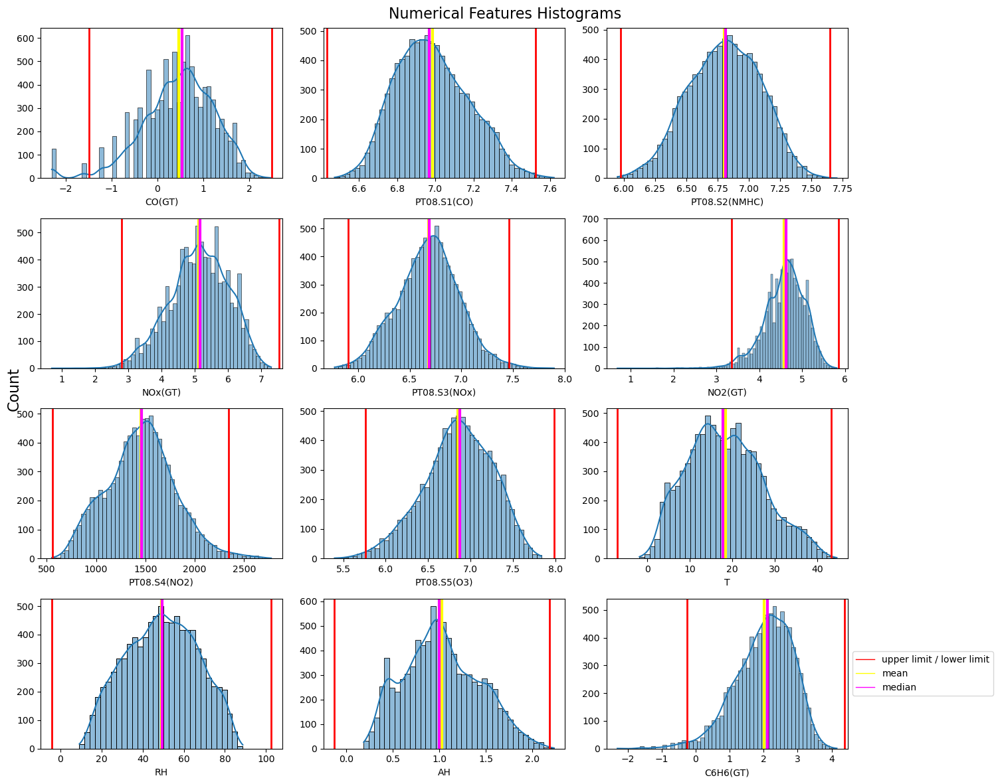

In [66]:
descriptive_plots(df)

The histograms above now look much like Gaussian distributions.

## Data Preparation

Now, we can split the data into training and testing sets.

In [70]:
df.pop("HourRange")
y = df.pop("C6H6(GT)")

In [71]:
X_train, X_test, y_train, y_test = train_test_split(df, y, test_size=0.2, random_state=100)

In [72]:
X_train

,CO(GT),PT08.S1(CO),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Hour,Month
3844,0.530628,6.748760,6.523562,4.174387,6.938284,4.219508,1368.0,6.124683,29.0,34.1,1.3445,10,8
4191,0.955511,7.015712,7.003974,6.006353,6.496775,4.564348,1632.0,6.963190,29.6,27.7,1.1278,18,9
8727,0.693147,7.149132,6.895683,5.662960,6.333280,4.812184,1387.0,7.136483,24.1,33.3,0.9881,15,3
7890,0.336472,6.930495,6.647688,5.356586,6.693324,4.962845,982.0,6.599870,9.3,42.3,0.4974,17,2
6053,0.587787,7.029973,6.818924,6.146329,6.546785,4.663439,1281.0,7.094235,10.6,80.3,1.0252,3,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...
350,0.993252,7.185387,6.942157,5.214936,6.804615,4.718499,1721.0,6.898715,8.7,74.6,0.8429,8,3
79,1.029619,7.302496,6.951772,5.159055,6.779922,4.779123,1624.0,7.333023,14.6,51.5,0.8536,1,3
8039,0.955511,7.043160,6.869014,5.968708,6.487684,5.420535,1212.0,7.083388,4.3,78.9,0.6621,22,2
6936,1.568616,7.368340,7.152269,6.739337,6.122493,5.153292,1567.0,7.572503,9.8,65.8,0.7967,10,1


## Standardization

For such prepared numerical data, we can apply standardization. It's worth mentioning that there is no need to standardize the target feature since it's just a scaling of the data. It will be also easier to apply only the inverse transformation when evaluating the results.

In [73]:
std_scaler = StandardScaler().fit(X_train[numerical_features])
X_train_scaled = std_scaler.transform(X_train[numerical_features])
X_test_scaled = std_scaler.transform(X_test[numerical_features])

X_train_num = pd.DataFrame(X_train_scaled, columns=numerical_features, index=X_train.index)
X_test_num = pd.DataFrame(X_test_scaled, columns=numerical_features, index=X_test.index)
X_train = pd.concat([X_train_num, X_train[categorical_features]], axis=1)
X_test = pd.concat([X_test_num, X_test[categorical_features]], axis=1)

In [74]:
X_train

,CO(GT),PT08.S1(CO),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Month,Hour
3844,0.088771,-1.243354,-0.993468,-1.071729,0.863896,-0.780671,-0.258491,-1.807061,1.205387,-0.872496,0.781517,8,10
4191,0.636599,0.163999,0.696633,1.010606,-0.625159,-0.048529,0.505335,0.268576,1.273338,-1.241058,0.246674,9,18
8727,0.298317,0.867374,0.315661,0.620283,-1.176570,0.477660,-0.203518,0.697546,0.650451,-0.918566,-0.098123,3,15
7890,-0.161566,-0.285261,-0.556789,0.272037,0.037730,0.797532,-1.375297,-0.630784,-1.025682,-0.400276,-1.309233,2,17
6053,0.162469,0.239179,0.045622,1.169712,-0.456491,0.161854,-0.510206,0.592964,-0.878454,1.788061,-0.006556,11,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...
350,0.685260,1.058509,0.479157,0.111028,0.413075,0.278753,0.762837,0.108974,-1.093634,1.459810,-0.456495,3,8
79,0.732151,1.675900,0.512985,0.047510,0.329796,0.407468,0.482189,1.184060,-0.425445,0.129532,-0.430086,3,1
8039,0.636599,0.308700,0.221841,0.967815,-0.655819,1.769270,-0.709842,0.566114,-1.591943,1.707438,-0.902733,2,22
6936,1.427111,2.023020,1.218337,1.843764,-1.887479,1.201876,0.317272,1.776868,-0.969056,0.953037,-0.570523,1,10


In [74]:
X_test

,CO(GT),PT08.S1(CO),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Month,Hour
3844,0.088771,-1.243354,-0.993468,-1.071729,0.863896,-0.780671,-0.258491,-1.807061,1.205387,-0.872496,0.781517,8,10
4191,0.636599,0.163999,0.696633,1.010606,-0.625159,-0.048529,0.505335,0.268576,1.273338,-1.241058,0.246674,9,18
8727,0.298317,0.867374,0.315661,0.620283,-1.176570,0.477660,-0.203518,0.697546,0.650451,-0.918566,-0.098123,3,15
7890,-0.161566,-0.285261,-0.556789,0.272037,0.037730,0.797532,-1.375297,-0.630784,-1.025682,-0.400276,-1.309233,2,17
6053,0.162469,0.239179,0.045622,1.169712,-0.456491,0.161854,-0.510206,0.592964,-0.878454,1.788061,-0.006556,11,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...
350,0.685260,1.058509,0.479157,0.111028,0.413075,0.278753,0.762837,0.108974,-1.093634,1.459810,-0.456495,3,8
79,0.732151,1.675900,0.512985,0.047510,0.329796,0.407468,0.482189,1.184060,-0.425445,0.129532,-0.430086,3,1
8039,0.636599,0.308700,0.221841,0.967815,-0.655819,1.769270,-0.709842,0.566114,-1.591943,1.707438,-0.902733,2,22
6936,1.427111,2.023020,1.218337,1.843764,-1.887479,1.201876,0.317272,1.776868,-0.969056,0.953037,-0.570523,1,10


- correlation importance after standardizing

Let's review the importance of correlation once again after data standardization.

In [75]:
check_correlation_importance(pd.concat([X_train, X_test], axis=0, ignore_index=True), corr_type="pearson")

All correlation pairs are statistically significant


In [76]:
check_correlation_importance(pd.concat([X_train, X_test], axis=0, ignore_index=True), corr_type="spearman")

All correlation pairs are statistically significant


- Standardized Numerical Features Histograms

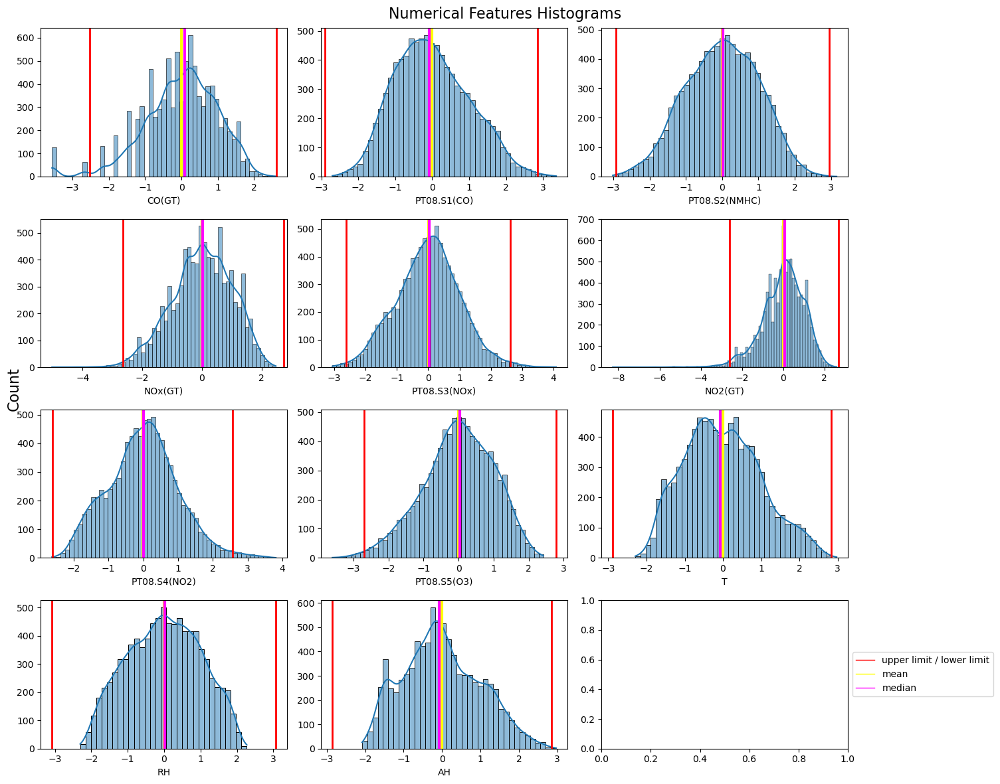

In [77]:
descriptive_plots(pd.concat([X_train, X_test], axis=0, ignore_index=True), include_target=False) # n_rows=6, n_cols=2

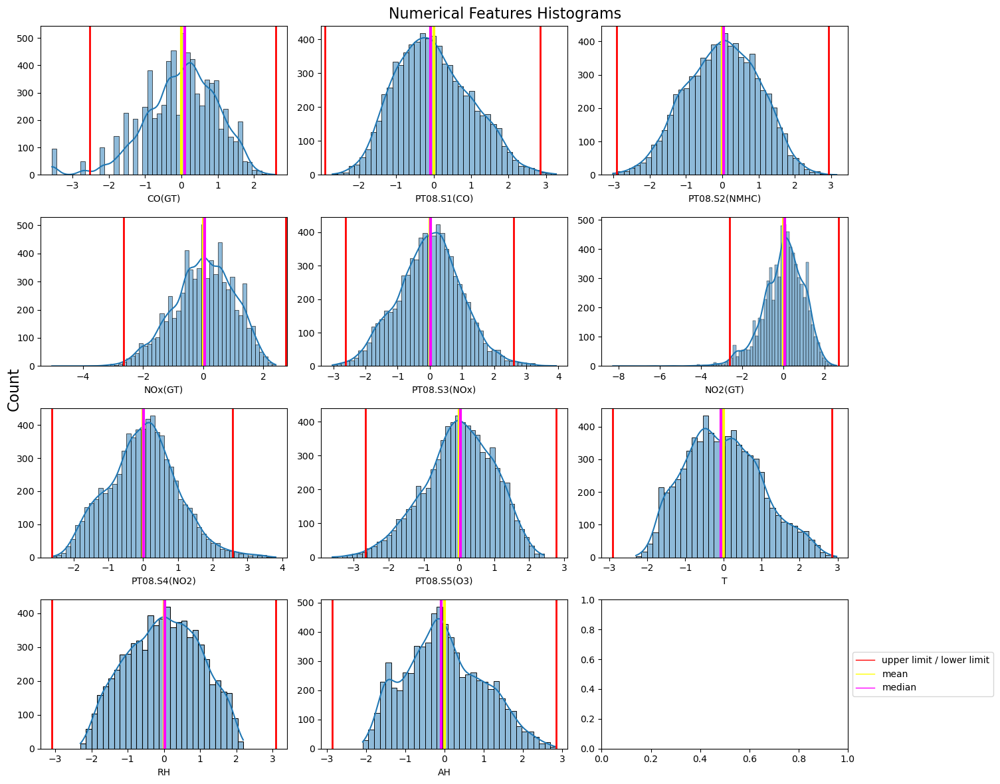

In [78]:
descriptive_plots(X_train, include_target=False)

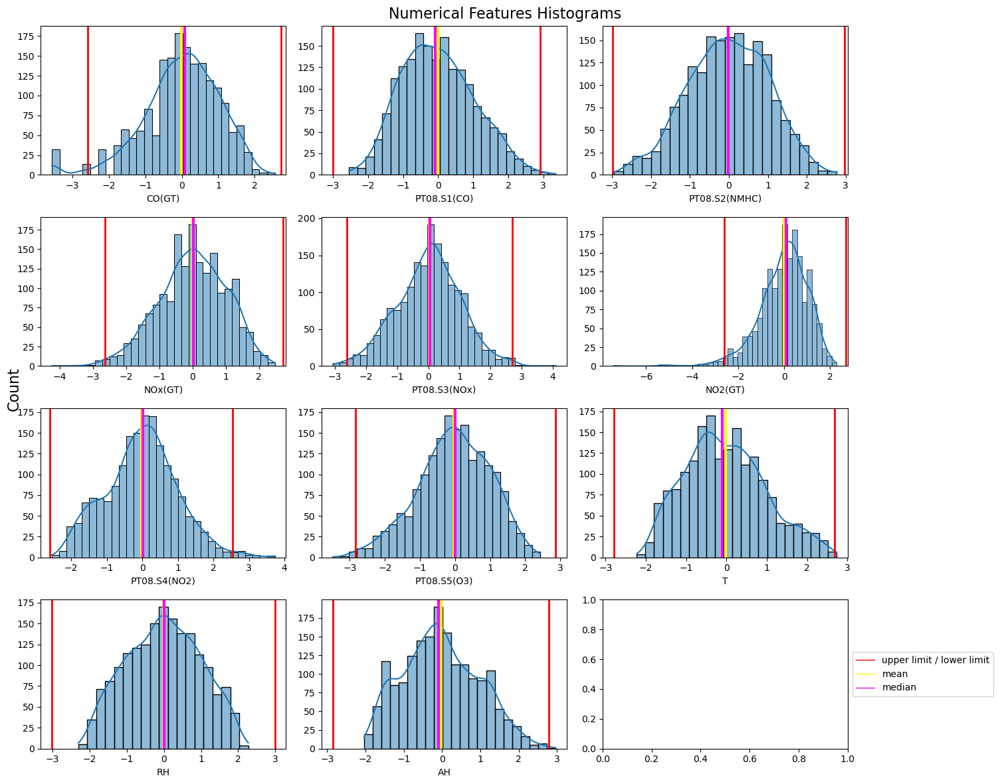

In [79]:
descriptive_plots(X_test, include_target=False)

- Target Feature Histograms

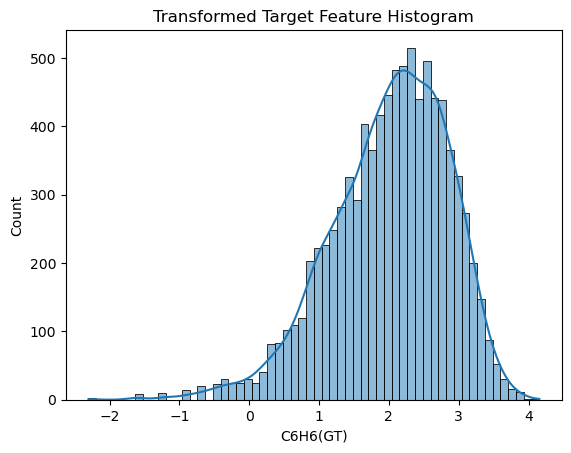

In [80]:
sns.histplot(y, kde=True)
plt.title("Transformed Target Feature Histogram")
plt.show()

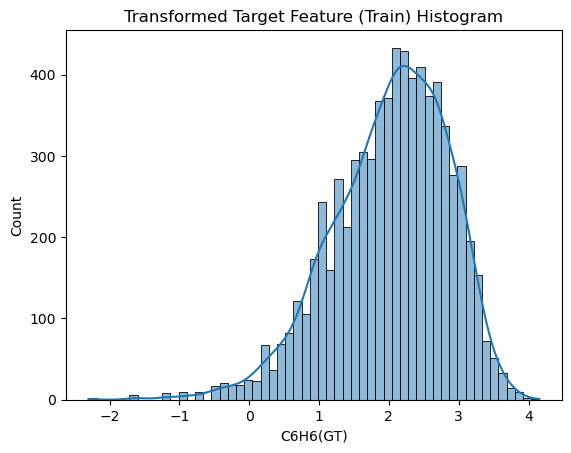

In [81]:
sns.histplot(y_train, kde=True)
plt.title("Transformed Target Feature (Train) Histogram")
plt.show()

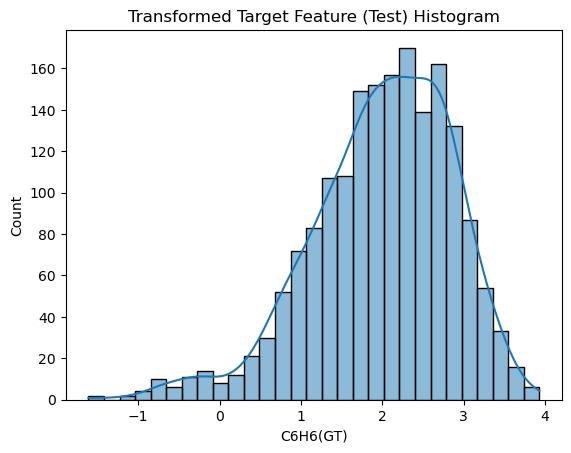

In [82]:
sns.histplot(y_test, kde=True)
plt.title("Transformed Target Feature (Test) Histogram")
plt.show()

## Categorical Data Encoding

In [83]:
oh_encoder = OneHotEncoder(drop="first", sparse=False)

preprocessor = ColumnTransformer(
    transformers=[
        ("cat", oh_encoder, categorical_features)
    ])

X_train_cat_enc = preprocessor.fit_transform(X_train)
X_test_cat_enc = preprocessor.transform(X_test)

oh_feature_names = preprocessor.named_transformers_["cat"].get_feature_names_out(input_features=categorical_features)

X_train_cat_enc = pd.DataFrame(X_train_cat_enc, columns=oh_feature_names, index=X_train.index)
X_test_cat_enc = pd.DataFrame(X_test_cat_enc, columns=oh_feature_names, index=X_test.index)

X_train = pd.concat([X_train_num, X_train_cat_enc], axis=1)
X_test = pd.concat([X_test_num, X_test_cat_enc], axis=1)

In [84]:
X_train.T

,3844,4191,8727,7890,6053,6106,6657,5302,1361,2908,...,4376,802,5646,7906,4149,350,79,8039,6936,5640
CO(GT),0.088771,0.636599,0.298317,-0.161566,0.162469,1.285281,0.478520,1.223871,0.162469,-1.055282,...,-1.055282,1.159389,-0.360321,0.586029,1.671112,0.685260,0.732151,0.636599,1.427111,0.162469
PT08.S1(CO),-1.243354,0.163999,0.867374,-0.285261,0.239179,1.760478,-0.357907,1.417439,-1.019498,-1.865841,...,-0.731344,1.432342,-1.237177,0.498618,1.364944,1.058509,1.675900,0.308700,2.023020,-0.053381
PT08.S2(NMHC),-0.993468,0.696633,0.315661,-0.556789,0.045622,1.488679,0.087663,1.089272,0.177681,-1.050757,...,-0.836861,1.131881,-0.896659,0.250976,1.918034,0.479157,0.512985,0.221841,1.218337,-0.024275
NOx(GT),-1.071729,1.010606,0.620283,0.272037,1.169712,1.869039,1.228988,1.152545,-0.433137,-1.369950,...,-0.473737,0.517066,-0.605036,1.193795,1.010606,0.111028,0.047510,0.967815,1.843764,0.454889
PT08.S3(NOx),0.863896,-0.625159,-1.176570,0.037730,-0.456491,-1.603897,-0.029809,-1.444530,0.552248,0.989121,...,0.626765,-0.594774,0.692796,-0.824223,-1.764032,0.413075,0.329796,-0.655819,-1.887479,-0.305099
NO2(GT),-0.780671,-0.048529,0.477660,0.797532,0.161854,0.706527,1.049250,0.371481,0.059267,-1.803678,...,-1.391459,-0.093228,-1.192890,1.499143,-0.048529,0.278753,0.407468,1.769270,1.201876,-0.357461
PT08.S4(NO2),-0.258491,0.505335,-0.203518,-1.375297,-0.510206,0.895928,-1.279818,1.144750,0.007691,-0.267171,...,0.120529,1.341493,-0.886332,-0.819787,1.720512,0.762837,0.482189,-0.709842,0.317272,-0.270064
PT08.S5(O3),-1.807061,0.268576,0.697546,-0.630784,0.592964,1.243210,0.321862,0.990637,-0.916037,-0.794362,...,-0.276777,0.969554,-0.878530,0.588852,1.373970,0.108974,1.184060,0.566114,1.776868,0.126397
T,1.205387,1.273338,0.650451,-1.025682,-0.878454,-0.946406,-1.195561,0.367320,0.163466,-0.198941,...,0.254068,-0.855804,-0.153640,-1.127609,1.092134,-1.093634,-0.425445,-1.591943,-0.969056,0.084190
RH,-0.872496,-1.241058,-0.918566,-0.400276,1.788061,1.482845,-0.417552,1.062454,-1.125883,0.434747,...,1.551951,0.849379,0.175602,-0.267824,-1.160435,1.459810,0.129532,1.707438,0.953037,0.572958


---

# Baseline Linear Regression Model Without Regularization 

- Helper functions for result scores and error distribution

In [85]:
def target_feature_values(model, X_train, X_test, y_train, y_test):
    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)

    # back to nominal value unit for the target feature (exponential transformation)
    y_train = np.exp(y_train)
    y_test = np.exp(y_test)
    y_train_pred = np.exp(y_train_pred)
    y_test_pred = np.exp(y_test_pred)
    
    return y_train, y_train_pred, y_test, y_test_pred

In [86]:
def print_metrics(model, X_train, X_test, y_train, y_test):
    y_train, y_train_pred, y_test, y_test_pred = target_feature_values(model, X_train, X_test, y_train, y_test)
    
    rmse_train = mse(y_train, y_train_pred, squared=False)
    rmse_test = mse(y_test, y_test_pred, squared=False)
    print(f"Train RMSE: {rmse_train:.2f}")
    print(f"Test RMSE: {rmse_test:.2f}", end="\n\n")
    
    mae_train = mae(y_train, y_train_pred)
    mae_test = mae(y_test, y_test_pred)
    print(f"Train MAE: {mae_train:.2f}")
    print(f"Test MAE: {mae_test:.2f}", end="\n\n")
    
    r2_train = r2(y_train, y_train_pred)
    r2_test = r2(y_test, y_test_pred)
    print(f"Train R-squared: {r2_train:.2f}")
    print(f"Test R-squared: {r2_test:.2f}", end="\n\n")

In [87]:
def plot_error_distribution(model, X_train, X_test, y_train, y_test, model_name):
    y_train, y_train_pred, y_test, y_test_pred = target_feature_values(model, X_train, X_test, y_train, y_test)
    errors = y_test - y_test_pred
    
    sns.scatterplot(x=y_test_pred, y=errors)
    plt.axhline(y=0, color="magenta")
    plt.xlabel("Predicted Values in Test Data")
    plt.ylabel("Errors")
    plt.title(f"Error Distribution for {model_name}")
    plt.grid()
    plt.show()

- model

In [88]:
reg_lin_model = LinearRegression()
reg_lin_model.fit(X_train, y_train)

LinearRegression()

- results

In [89]:
print_metrics(reg_lin_model, X_train, X_test, y_train, y_test)

Train RMSE: 1.11
Test RMSE: 0.94

Train MAE: 0.49
Test MAE: 0.47

Train R-squared: 0.98
Test R-squared: 0.98



In [90]:
np.exp(y_train).describe()

count    7192.000000
mean       10.094814
std         7.415231
min         0.100000
25%         4.500000
50%         8.300000
75%        14.000000
max        63.700000
Name: C6H6(GT), dtype: float64

In [91]:
np.exp(y_test).describe()

count    1799.000000
mean       10.036298
std         7.588432
min         0.200000
25%         4.350000
50%         8.000000
75%        13.900000
max        50.800000
Name: C6H6(GT), dtype: float64

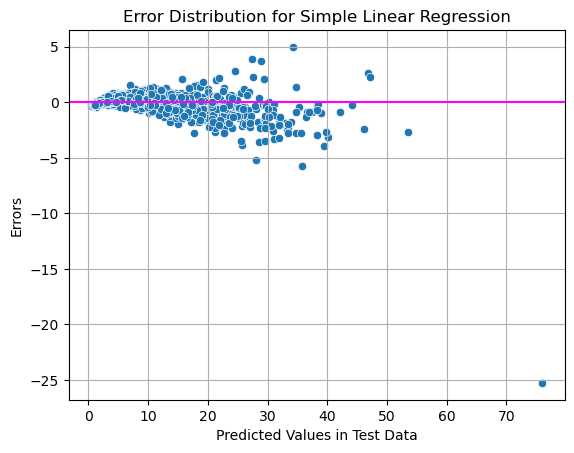

In [92]:
plot_error_distribution(reg_lin_model, X_train, X_test, y_train, y_test, "Simple Linear Regression")

---

# Model With Ridge Regularization 

- model

In [93]:
reg_ridge_model = Ridge(random_state=100)
reg_ridge_model.fit(X_train, y_train)

Ridge(random_state=100)

- results

In [94]:
print_metrics(reg_ridge_model, X_train, X_test, y_train, y_test)

Train RMSE: 1.10
Test RMSE: 0.93

Train MAE: 0.49
Test MAE: 0.47

Train R-squared: 0.98
Test R-squared: 0.98



---

# Model With Ridge, Lass, ElasticNet Regularization and Cross-Validation

- RidgeCV

In [95]:
alphas_ridge = np.linspace(0.1, 100, 1000)
reg_ridge_cv = RidgeCV(alphas=alphas_ridge, cv=5)
reg_ridge_cv.fit(X_train, y_train)

RidgeCV(alphas=array([  0.1,   0.2,   0.3,   0.4,   0.5,   0.6,   0.7,   0.8,   0.9,
         1. ,   1.1,   1.2,   1.3,   1.4,   1.5,   1.6,   1.7,   1.8,
         1.9,   2. ,   2.1,   2.2,   2.3,   2.4,   2.5,   2.6,   2.7,
         2.8,   2.9,   3. ,   3.1,   3.2,   3.3,   3.4,   3.5,   3.6,
         3.7,   3.8,   3.9,   4. ,   4.1,   4.2,   4.3,   4.4,   4.5,
         4.6,   4.7,   4.8,   4.9,   5. ,   5.1,   5.2,   5.3,   5.4,
         5.5,   5.6,   5.7,   5.8,   5.9,   6. ,   6.1,   6.2,   6.3,
         6.4,   6.5,   6.6,   6.7,   6.8,   6.9,   7. ,   7.1,   7.2,
         7.3,   7.4,   7.5,   7.6,   7.7,   7.8,   7.9,   8. ,   8.1,
         8.2,   8.3,   8.4,...
        92.8,  92.9,  93. ,  93.1,  93.2,  93.3,  93.4,  93.5,  93.6,
        93.7,  93.8,  93.9,  94. ,  94.1,  94.2,  94.3,  94.4,  94.5,
        94.6,  94.7,  94.8,  94.9,  95. ,  95.1,  95.2,  95.3,  95.4,
        95.5,  95.6,  95.7,  95.8,  95.9,  96. ,  96.1,  96.2,  96.3,
        96.4,  96.5,  96.6,  96.7,  96.8,  96.9,  97. ,  97.1,  97.2,
        97.3,  97.4,  97.5,  97.6,  97.7,  97.8,  97.9,  98. ,  98.1,
        98.2,  98.3,  98.4,  98.5,  98.6,  98.7,  98.8,  98.9,  99. ,
        99.1,  99.2,  99.3,  99.4,  99.5,  99.6,  99.7,  99.8,  99.9,
       100. ]),
        cv=5)

In [96]:
alpha_ridge_cv_best = round(reg_ridge_cv.alpha_, 4)
print(f"Best alpha hyperparameter value for RidgeCV: {alpha_ridge_cv_best}")

Best alpha hyperparameter value for RidgeCV: 0.5


In [97]:
print_metrics(reg_ridge_cv, X_train, X_test, y_train, y_test)

Train RMSE: 1.10
Test RMSE: 0.94

Train MAE: 0.49
Test MAE: 0.47

Train R-squared: 0.98
Test R-squared: 0.98



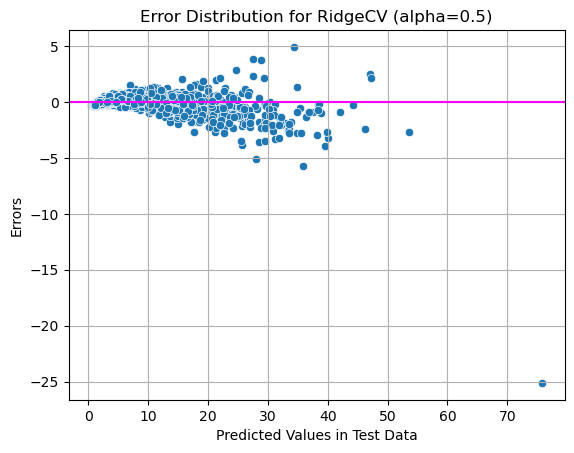

In [98]:
plot_error_distribution(reg_ridge_cv, X_train, X_test, y_train, y_test, 
                        f"RidgeCV (alpha={alpha_ridge_cv_best})")

- LassoCV

In [99]:
alphas_lasso = np.linspace(0.1, 100, 1000)
reg_lasso_cv = LassoCV(alphas=alphas_lasso, cv=5)
reg_lasso_cv.fit(X_train, y_train)

LassoCV(alphas=array([  0.1,   0.2,   0.3,   0.4,   0.5,   0.6,   0.7,   0.8,   0.9,
         1. ,   1.1,   1.2,   1.3,   1.4,   1.5,   1.6,   1.7,   1.8,
         1.9,   2. ,   2.1,   2.2,   2.3,   2.4,   2.5,   2.6,   2.7,
         2.8,   2.9,   3. ,   3.1,   3.2,   3.3,   3.4,   3.5,   3.6,
         3.7,   3.8,   3.9,   4. ,   4.1,   4.2,   4.3,   4.4,   4.5,
         4.6,   4.7,   4.8,   4.9,   5. ,   5.1,   5.2,   5.3,   5.4,
         5.5,   5.6,   5.7,   5.8,   5.9,   6. ,   6.1,   6.2,   6.3,
         6.4,   6.5,   6.6,   6.7,   6.8,   6.9,   7. ,   7.1,   7.2,
         7.3,   7.4,   7.5,   7.6,   7.7,   7.8,   7.9,   8. ,   8.1,
         8.2,   8.3,   8.4,...
        92.8,  92.9,  93. ,  93.1,  93.2,  93.3,  93.4,  93.5,  93.6,
        93.7,  93.8,  93.9,  94. ,  94.1,  94.2,  94.3,  94.4,  94.5,
        94.6,  94.7,  94.8,  94.9,  95. ,  95.1,  95.2,  95.3,  95.4,
        95.5,  95.6,  95.7,  95.8,  95.9,  96. ,  96.1,  96.2,  96.3,
        96.4,  96.5,  96.6,  96.7,  96.8,  96.9,  97. ,  97.1,  97.2,
        97.3,  97.4,  97.5,  97.6,  97.7,  97.8,  97.9,  98. ,  98.1,
        98.2,  98.3,  98.4,  98.5,  98.6,  98.7,  98.8,  98.9,  99. ,
        99.1,  99.2,  99.3,  99.4,  99.5,  99.6,  99.7,  99.8,  99.9,
       100. ]),
        cv=5)

In [100]:
alpha_lasso_cv_best = round(reg_lasso_cv.alpha_, 4)
print(f"Best alpha hyperparameter value for LassoCV: {alpha_lasso_cv_best}")

Best alpha hyperparameter value for LassoCV: 0.1


In [101]:
print_metrics(reg_lasso_cv, X_train, X_test, y_train, y_test)

Train RMSE: 0.75
Test RMSE: 0.75

Train MAE: 0.63
Test MAE: 0.62

Train R-squared: 0.99
Test R-squared: 0.99



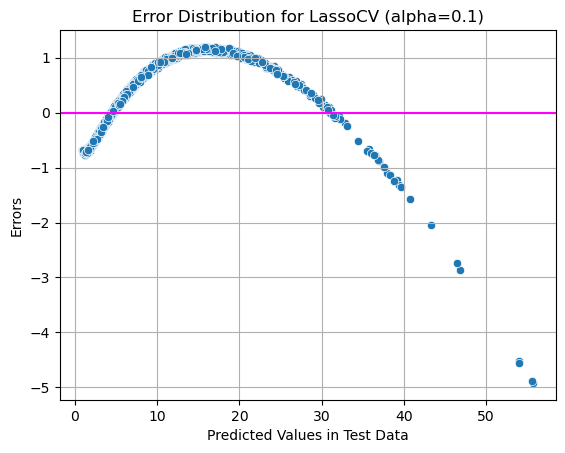

In [102]:
plot_error_distribution(reg_lasso_cv, X_train, X_test, y_train, y_test, 
                        f"LassoCV (alpha={alpha_lasso_cv_best})")

- ElasticNetCV

In [103]:
alphas_elastic = np.linspace(0.1, 20, 100)
l1_ratios = np.linspace(0.1, 1, 100)
reg_elnet_cv = ElasticNetCV(alphas=alphas_elastic, l1_ratio=l1_ratios, cv=5)
reg_elnet_cv.fit(X_train, y_train)

ElasticNetCV(alphas=array([ 0.1       ,  0.3010101 ,  0.5020202 ,  0.7030303 ,  0.9040404 ,
        1.10505051,  1.30606061,  1.50707071,  1.70808081,  1.90909091,
        2.11010101,  2.31111111,  2.51212121,  2.71313131,  2.91414141,
        3.11515152,  3.31616162,  3.51717172,  3.71818182,  3.91919192,
        4.12020202,  4.32121212,  4.52222222,  4.72323232,  4.92424242,
        5.12525253,  5.32626263,  5.52727273,  5.72828283,  5.92929293,
        6.13...
       0.69090909, 0.7       , 0.70909091, 0.71818182, 0.72727273,
       0.73636364, 0.74545455, 0.75454545, 0.76363636, 0.77272727,
       0.78181818, 0.79090909, 0.8       , 0.80909091, 0.81818182,
       0.82727273, 0.83636364, 0.84545455, 0.85454545, 0.86363636,
       0.87272727, 0.88181818, 0.89090909, 0.9       , 0.90909091,
       0.91818182, 0.92727273, 0.93636364, 0.94545455, 0.95454545,
       0.96363636, 0.97272727, 0.98181818, 0.99090909, 1.        ]))

In [104]:
alpha_elastic_cv_best = round(reg_elnet_cv.alpha_, 4)
l1_ratio_cv_best = round(reg_elnet_cv.l1_ratio_, 4)
print(f"Best alpha hyperparameter value for ElasticNetCV: {alpha_elastic_cv_best}")
print(f"Best l1 ratio hyperparameter value for ElasticNetCV: {l1_ratio_cv_best}")

Best alpha hyperparameter value for ElasticNetCV: 0.1
Best l1 ratio hyperparameter value for ElasticNetCV: 0.4182


In [105]:
print_metrics(reg_elnet_cv, X_train, X_test, y_train, y_test)

Train RMSE: 0.99
Test RMSE: 1.02

Train MAE: 0.67
Test MAE: 0.68

Train R-squared: 0.98
Test R-squared: 0.98



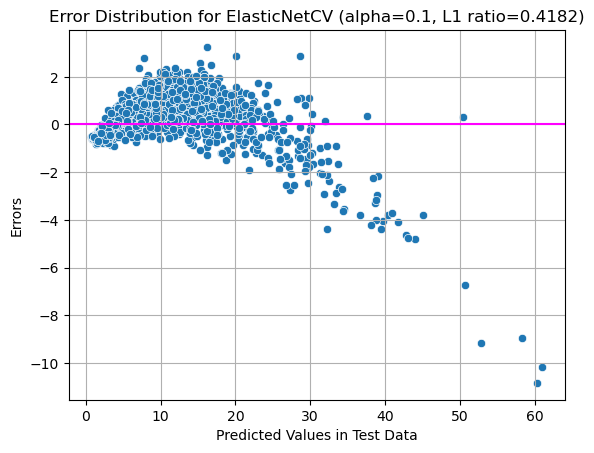

In [106]:
plot_error_distribution(reg_elnet_cv, X_train, X_test, y_train, y_test, 
                        f"ElasticNetCV (alpha={alpha_elastic_cv_best}, L1 ratio={l1_ratio_cv_best})")

---

# Polynomial Regression

In [107]:
poly_features = PolynomialFeatures(degree=2, interaction_only=True)
X_train_poly = poly_features.fit_transform(X_train)
X_test_poly = poly_features.transform(X_test)

In [108]:
alphas_elastic = np.linspace(0.1, 20, 100)
l1_ratios = np.linspace(0.1, 1, 100)
poly_elnet_cv = ElasticNetCV(alphas=alphas_elastic, l1_ratio=l1_ratios, cv=5)
poly_elnet_cv.fit(X_train_poly, y_train)

ElasticNetCV(alphas=array([ 0.1       ,  0.3010101 ,  0.5020202 ,  0.7030303 ,  0.9040404 ,
        1.10505051,  1.30606061,  1.50707071,  1.70808081,  1.90909091,
        2.11010101,  2.31111111,  2.51212121,  2.71313131,  2.91414141,
        3.11515152,  3.31616162,  3.51717172,  3.71818182,  3.91919192,
        4.12020202,  4.32121212,  4.52222222,  4.72323232,  4.92424242,
        5.12525253,  5.32626263,  5.52727273,  5.72828283,  5.92929293,
        6.13...
       0.69090909, 0.7       , 0.70909091, 0.71818182, 0.72727273,
       0.73636364, 0.74545455, 0.75454545, 0.76363636, 0.77272727,
       0.78181818, 0.79090909, 0.8       , 0.80909091, 0.81818182,
       0.82727273, 0.83636364, 0.84545455, 0.85454545, 0.86363636,
       0.87272727, 0.88181818, 0.89090909, 0.9       , 0.90909091,
       0.91818182, 0.92727273, 0.93636364, 0.94545455, 0.95454545,
       0.96363636, 0.97272727, 0.98181818, 0.99090909, 1.        ]))

In [109]:
alpha_elastic_cv_best = round(poly_elnet_cv.alpha_, 4)
l1_ratio_cv_best = round(poly_elnet_cv.l1_ratio_, 4)
print(f"Best alpha hyperparameter value for PolyFeatures with ElasticNetCV: {alpha_elastic_cv_best}")
print(f"Best l1 ratio hyperparameter value for PolyFeatures with ElasticNetCV: {l1_ratio_cv_best}")

Best alpha hyperparameter value for PolyFeatures with ElasticNetCV: 0.1
Best l1 ratio hyperparameter value for PolyFeatures with ElasticNetCV: 0.1909


In [110]:
print_metrics(poly_elnet_cv, X_train_poly, X_test_poly, y_train, y_test)

Train RMSE: 1.08
Test RMSE: 1.09

Train MAE: 0.66
Test MAE: 0.66

Train R-squared: 0.98
Test R-squared: 0.98



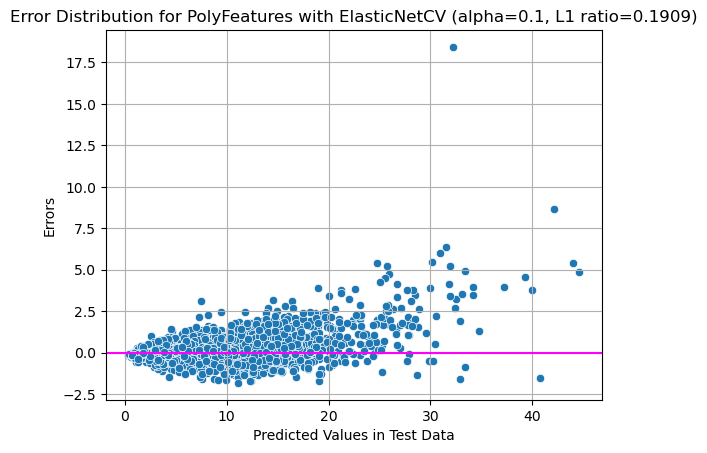

In [111]:
plot_error_distribution(poly_elnet_cv, X_train_poly, X_test_poly, y_train, y_test, 
                        f"PolyFeatures with ElasticNetCV (alpha={alpha_elastic_cv_best}, L1 ratio={l1_ratio_cv_best})")

---

# Features Importance

In [112]:
def plot_feature_importance(model, head, model_name):
    columns = X_train.columns
    importance_values = np.abs(model.coef_)
    indices = np.argsort(importance_values)[::-1][:head]
    
    plt.figure(figsize=(10, 7))
    sns.barplot(x=np.array(columns)[indices], y=importance_values[indices])
    plt.xticks(rotation=90)
    plt.xlabel("Feature Name")
    plt.ylabel("Feature Importance")
    plt.title(f"Top most important features for {model_name}")
    plt.tight_layout()
    plt.show()

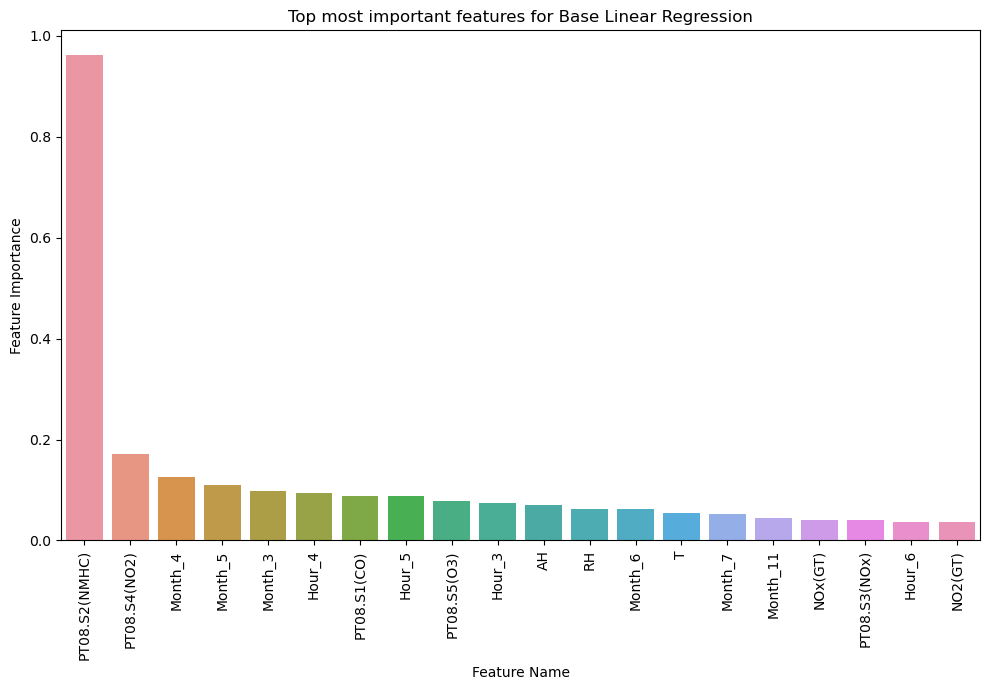

In [113]:
plot_feature_importance(reg_lin_model, 20, "Base Linear Regression")

---

# Additional Steps: remove most important feature 'PT08.S2(NMHC)'

In [114]:
X_train.pop("PT08.S2(NMHC)")

3844   -0.993468
4191    0.696633
8727    0.315661
7890   -0.556789
6053    0.045622
          ...   
350     0.479157
79      0.512985
8039    0.221841
6936    1.218337
5640   -0.024275
Name: PT08.S2(NMHC), Length: 7192, dtype: float64

In [115]:
X_test.pop("PT08.S2(NMHC)")

8448   -1.206424
5948    1.616440
5053   -0.201218
4839    1.134703
8976   -0.983151
          ...   
3923    0.091460
4876   -0.686929
5733    1.025831
4214    0.431246
4017    0.287059
Name: PT08.S2(NMHC), Length: 1799, dtype: float64

## Baseline Linear Regression Results

In [116]:
reg_lin_model.fit(X_train, y_train)

LinearRegression()

In [117]:
print_metrics(reg_lin_model, X_train, X_test, y_train, y_test)

Train RMSE: 2.53
Test RMSE: 2.61

Train MAE: 1.35
Test MAE: 1.35

Train R-squared: 0.88
Test R-squared: 0.88



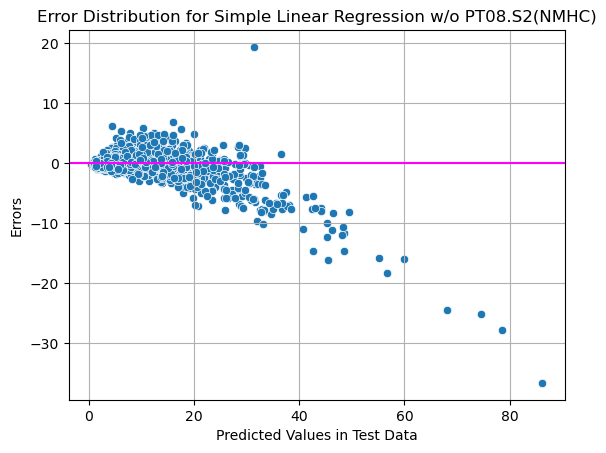

In [118]:
plot_error_distribution(reg_lin_model, X_train, X_test, y_train, y_test, "Simple Linear Regression w/o PT08.S2(NMHC)")

## Model With Ridge Regularization and Cross-Validation

In [119]:
reg_ridge_cv.fit(X_train, y_train)

RidgeCV(alphas=array([  0.1,   0.2,   0.3,   0.4,   0.5,   0.6,   0.7,   0.8,   0.9,
         1. ,   1.1,   1.2,   1.3,   1.4,   1.5,   1.6,   1.7,   1.8,
         1.9,   2. ,   2.1,   2.2,   2.3,   2.4,   2.5,   2.6,   2.7,
         2.8,   2.9,   3. ,   3.1,   3.2,   3.3,   3.4,   3.5,   3.6,
         3.7,   3.8,   3.9,   4. ,   4.1,   4.2,   4.3,   4.4,   4.5,
         4.6,   4.7,   4.8,   4.9,   5. ,   5.1,   5.2,   5.3,   5.4,
         5.5,   5.6,   5.7,   5.8,   5.9,   6. ,   6.1,   6.2,   6.3,
         6.4,   6.5,   6.6,   6.7,   6.8,   6.9,   7. ,   7.1,   7.2,
         7.3,   7.4,   7.5,   7.6,   7.7,   7.8,   7.9,   8. ,   8.1,
         8.2,   8.3,   8.4,...
        92.8,  92.9,  93. ,  93.1,  93.2,  93.3,  93.4,  93.5,  93.6,
        93.7,  93.8,  93.9,  94. ,  94.1,  94.2,  94.3,  94.4,  94.5,
        94.6,  94.7,  94.8,  94.9,  95. ,  95.1,  95.2,  95.3,  95.4,
        95.5,  95.6,  95.7,  95.8,  95.9,  96. ,  96.1,  96.2,  96.3,
        96.4,  96.5,  96.6,  96.7,  96.8,  96.9,  97. ,  97.1,  97.2,
        97.3,  97.4,  97.5,  97.6,  97.7,  97.8,  97.9,  98. ,  98.1,
        98.2,  98.3,  98.4,  98.5,  98.6,  98.7,  98.8,  98.9,  99. ,
        99.1,  99.2,  99.3,  99.4,  99.5,  99.6,  99.7,  99.8,  99.9,
       100. ]),
        cv=5)

In [120]:
print_metrics(reg_ridge_cv, X_train, X_test, y_train, y_test)

Train RMSE: 2.53
Test RMSE: 2.61

Train MAE: 1.35
Test MAE: 1.35

Train R-squared: 0.88
Test R-squared: 0.88



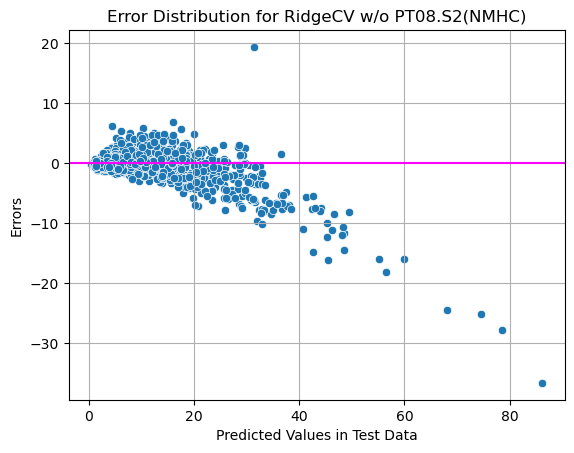

In [121]:
plot_error_distribution(reg_ridge_cv, X_train, X_test, y_train, y_test, "RidgeCV w/o PT08.S2(NMHC)")

## Model With Lasso Regularization and Cross-Validation

In [122]:
reg_lasso_cv.fit(X_train, y_train)

LassoCV(alphas=array([  0.1,   0.2,   0.3,   0.4,   0.5,   0.6,   0.7,   0.8,   0.9,
         1. ,   1.1,   1.2,   1.3,   1.4,   1.5,   1.6,   1.7,   1.8,
         1.9,   2. ,   2.1,   2.2,   2.3,   2.4,   2.5,   2.6,   2.7,
         2.8,   2.9,   3. ,   3.1,   3.2,   3.3,   3.4,   3.5,   3.6,
         3.7,   3.8,   3.9,   4. ,   4.1,   4.2,   4.3,   4.4,   4.5,
         4.6,   4.7,   4.8,   4.9,   5. ,   5.1,   5.2,   5.3,   5.4,
         5.5,   5.6,   5.7,   5.8,   5.9,   6. ,   6.1,   6.2,   6.3,
         6.4,   6.5,   6.6,   6.7,   6.8,   6.9,   7. ,   7.1,   7.2,
         7.3,   7.4,   7.5,   7.6,   7.7,   7.8,   7.9,   8. ,   8.1,
         8.2,   8.3,   8.4,...
        92.8,  92.9,  93. ,  93.1,  93.2,  93.3,  93.4,  93.5,  93.6,
        93.7,  93.8,  93.9,  94. ,  94.1,  94.2,  94.3,  94.4,  94.5,
        94.6,  94.7,  94.8,  94.9,  95. ,  95.1,  95.2,  95.3,  95.4,
        95.5,  95.6,  95.7,  95.8,  95.9,  96. ,  96.1,  96.2,  96.3,
        96.4,  96.5,  96.6,  96.7,  96.8,  96.9,  97. ,  97.1,  97.2,
        97.3,  97.4,  97.5,  97.6,  97.7,  97.8,  97.9,  98. ,  98.1,
        98.2,  98.3,  98.4,  98.5,  98.6,  98.7,  98.8,  98.9,  99. ,
        99.1,  99.2,  99.3,  99.4,  99.5,  99.6,  99.7,  99.8,  99.9,
       100. ]),
        cv=5)

In [123]:
print_metrics(reg_lasso_cv, X_train, X_test, y_train, y_test)

Train RMSE: 2.36
Test RMSE: 2.28

Train MAE: 1.66
Test MAE: 1.61

Train R-squared: 0.90
Test R-squared: 0.91



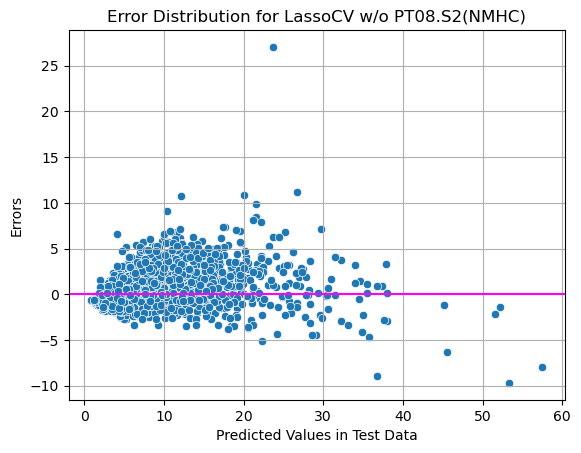

In [124]:
plot_error_distribution(reg_lasso_cv, X_train, X_test, y_train, y_test, "LassoCV w/o PT08.S2(NMHC)")

## Model With ElasticNet Regularization and Cross-Validation

In [125]:
reg_elnet_cv.fit(X_train, y_train)

ElasticNetCV(alphas=array([ 0.1       ,  0.3010101 ,  0.5020202 ,  0.7030303 ,  0.9040404 ,
        1.10505051,  1.30606061,  1.50707071,  1.70808081,  1.90909091,
        2.11010101,  2.31111111,  2.51212121,  2.71313131,  2.91414141,
        3.11515152,  3.31616162,  3.51717172,  3.71818182,  3.91919192,
        4.12020202,  4.32121212,  4.52222222,  4.72323232,  4.92424242,
        5.12525253,  5.32626263,  5.52727273,  5.72828283,  5.92929293,
        6.13...
       0.69090909, 0.7       , 0.70909091, 0.71818182, 0.72727273,
       0.73636364, 0.74545455, 0.75454545, 0.76363636, 0.77272727,
       0.78181818, 0.79090909, 0.8       , 0.80909091, 0.81818182,
       0.82727273, 0.83636364, 0.84545455, 0.85454545, 0.86363636,
       0.87272727, 0.88181818, 0.89090909, 0.9       , 0.90909091,
       0.91818182, 0.92727273, 0.93636364, 0.94545455, 0.95454545,
       0.96363636, 0.97272727, 0.98181818, 0.99090909, 1.        ]))

In [126]:
print_metrics(reg_elnet_cv, X_train, X_test, y_train, y_test)

Train RMSE: 2.70
Test RMSE: 2.63

Train MAE: 1.62
Test MAE: 1.60

Train R-squared: 0.87
Test R-squared: 0.88



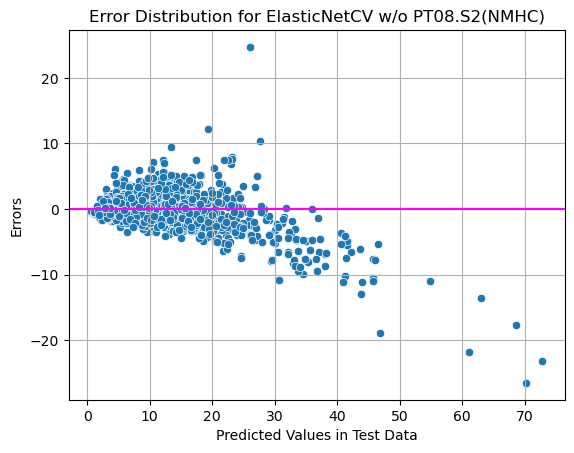

In [127]:
plot_error_distribution(reg_elnet_cv, X_train, X_test, y_train, y_test, "ElasticNetCV w/o PT08.S2(NMHC)")

## Features Importance w/o 'PT08.S2(NMHC)' feature

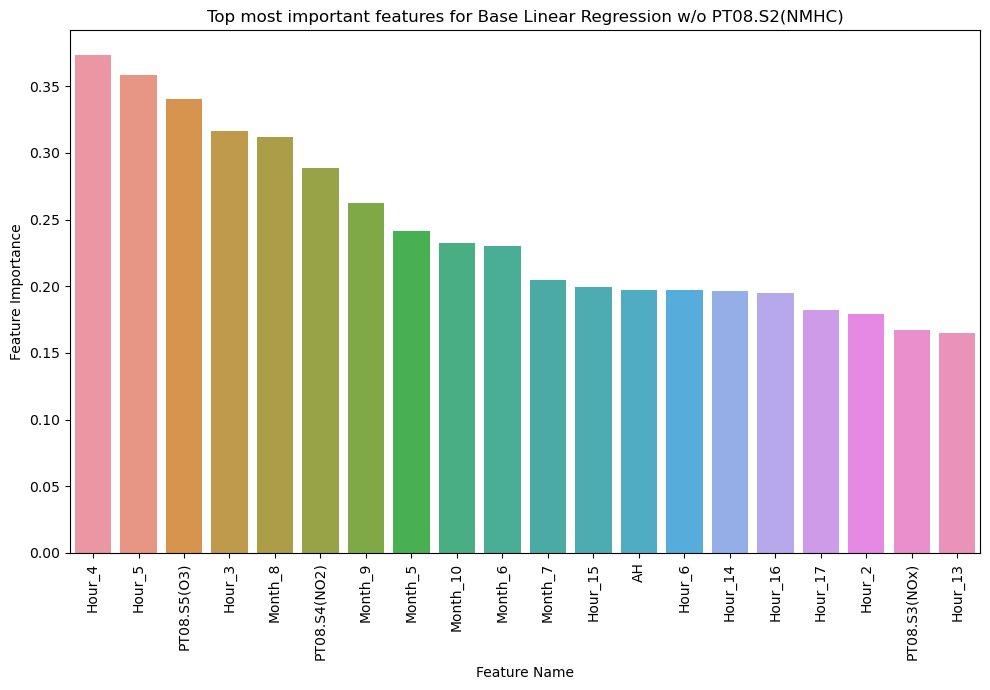

In [128]:
plot_feature_importance(reg_lin_model, 20, "Base Linear Regression w/o PT08.S2(NMHC)")